<a href="https://colab.research.google.com/github/Amit2balag/Scaler-Projects/blob/main/LoanTap_Logistic_Regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

LoanTap is an online platform committed to delivering customized loan products to millennials. They innovate in an otherwise dull loan segment, to deliver instant, flexible loans on consumer friendly terms to salaried professionals and businessmen.

The data science team at LoanTap is building an underwriting layer to determine the creditworthiness of MSMEs as well as individuals.

LoanTap deploys formal credit to salaried individuals and businesses 4 main financial instruments:

>Personal Loan

>EMI Free Loan

>Personal Overdraft

>Advance Salary Loan

This case study will focus on the underwriting process behind Personal Loan only

**Problem Statement:**

Given a set of attributes for an Individual, determine if a credit line should be extended to them. If so, what should the repayment terms be in business recommendations?

In [1]:
import pandas as pd
import numpy  as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
!gdown https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/003/549/original/logistic_regression.csv?1651045921

Downloading...
From: https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/003/549/original/logistic_regression.csv?1651045921
To: /content/logistic_regression.csv?1651045921
100% 100M/100M [00:00<00:00, 176MB/s] 


In [3]:
df = pd.read_csv("https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/003/549/original/logistic_regression.csv?1651045921")
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address
0,10000.0,36 months,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,...,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690"
1,8000.0,36 months,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,...,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113"


In [4]:
def months_to_years(months_str):
    months = int(months_str.split()[0])
    years = months / 12
    return years
df['term'] = df['term'].apply(months_to_years)
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,...,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690"
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,...,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113"


**Data dictionary:**

>loan_amnt : The listed amount of the loan applied for by the borrower. If at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.

>term : The number of payments on the loan. Values are in months and can be either 36 or 60.

>int_rate : Interest Rate on the loan

>installment : The monthly payment owed by the borrower if the loan originates.

>grade : LoanTap assigned loan grade

>sub_grade : LoanTap assigned loan subgrade

>emp_title :The job title supplied by the Borrower when applying for the loan.*

>emp_length : Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.

>home_ownership : The home ownership status provided by the borrower during registration or obtained from the credit report.

>annual_inc : The self-reported annual income provided by the borrower during registration.

>verification_status : Indicates if income was verified by LoanTap, not verified, or if the income source was verified

>issue_d : The month which the loan was funded

>**loan_status : Current status of the loan - Target Variable**

>purpose : A category provided by the borrower for the loan request.

>title : The loan title provided by the borrower

>dti : A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LoanTap loan, divided by the borrower’s self-reported monthly income.

>earliest_cr_line :The month the borrower's earliest reported credit line was opened

>open_acc : The number of open credit lines in the borrower's credit file.

>pub_rec : Number of derogatory public records

>revol_bal : Total credit revolving balance

>revol_util : Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.

>total_acc : The total number of credit lines currently in the borrower's credit file

>initial_list_status : The initial listing status of the loan. Possible values are – W, F

>application_type : Indicates whether the loan is an individual application or a joint application with two co-borrowers

>mort_acc : Number of mortgage accounts.

>pub_rec_bankruptcies : Number of public record bankruptcies

>Address: Address of the individual

In [5]:
df.columns

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'purpose', 'title',
       'dti', 'earliest_cr_line', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'application_type',
       'mort_acc', 'pub_rec_bankruptcies', 'address'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396030 entries, 0 to 396029
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             396030 non-null  float64
 1   term                  396030 non-null  float64
 2   int_rate              396030 non-null  float64
 3   installment           396030 non-null  float64
 4   grade                 396030 non-null  object 
 5   sub_grade             396030 non-null  object 
 6   emp_title             373103 non-null  object 
 7   emp_length            377729 non-null  object 
 8   home_ownership        396030 non-null  object 
 9   annual_inc            396030 non-null  float64
 10  verification_status   396030 non-null  object 
 11  issue_d               396030 non-null  object 
 12  loan_status           396030 non-null  object 
 13  purpose               396030 non-null  object 
 14  title                 394275 non-null  object 
 15  

In [7]:
df.describe()

,loan_amnt,term,int_rate,installment,annual_inc,dti,open_acc,pub_rec,revol_bal,revol_util,total_acc,mort_acc,pub_rec_bankruptcies
count,396030.000000,396030.000000,396030.000000,396030.000000,3.960300e+05,396030.000000,396030.000000,396030.000000,3.960300e+05,395754.000000,396030.000000,358235.000000,395495.000000
mean,14113.888089,3.474838,13.639400,431.849698,7.420318e+04,17.379514,11.311153,0.178191,1.584454e+04,53.791749,25.414744,1.813991,0.121648
std,8357.441341,0.851003,4.472157,250.727790,6.163762e+04,18.019092,5.137649,0.530671,2.059184e+04,24.452193,11.886991,2.147930,0.356174
min,500.000000,3.000000,5.320000,16.080000,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,2.000000,0.000000,0.000000
25%,8000.000000,3.000000,10.490000,250.330000,4.500000e+04,11.280000,8.000000,0.000000,6.025000e+03,35.800000,17.000000,0.000000,0.000000
50%,12000.000000,3.000000,13.330000,375.430000,6.400000e+04,16.910000,10.000000,0.000000,1.118100e+04,54.800000,24.000000,1.000000,0.000000
75%,20000.000000,3.000000,16.490000,567.300000,9.000000e+04,22.980000,14.000000,0.000000,1.962000e+04,72.900000,32.000000,3.000000,0.000000
max,40000.000000,5.000000,30.990000,1533.810000,8.706582e+06,9999.000000,90.000000,86.000000,1.743266e+06,892.300000,151.000000,34.000000,8.000000


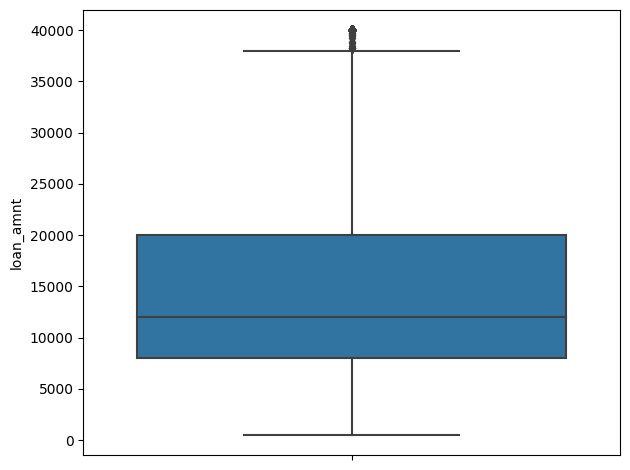

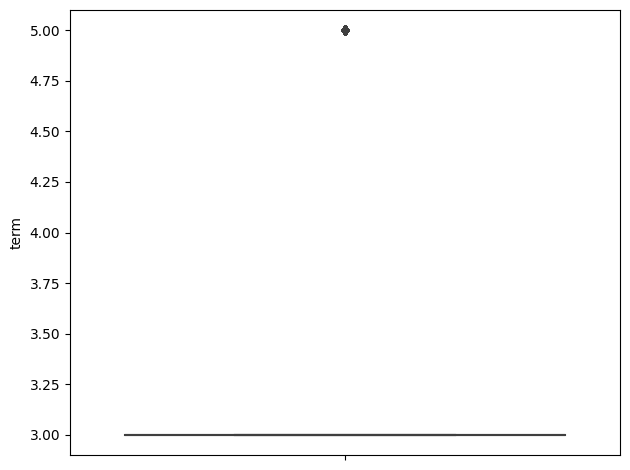

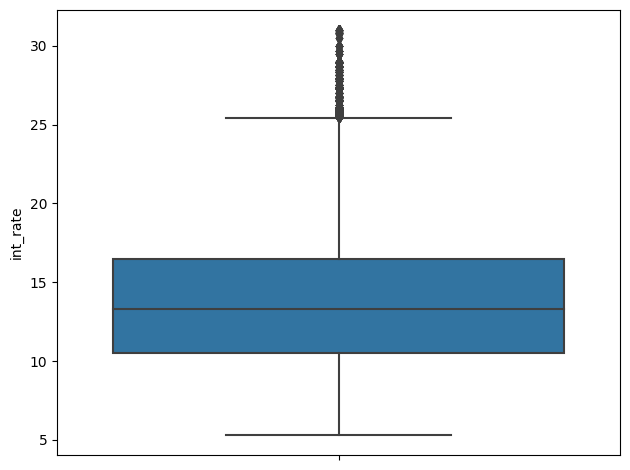

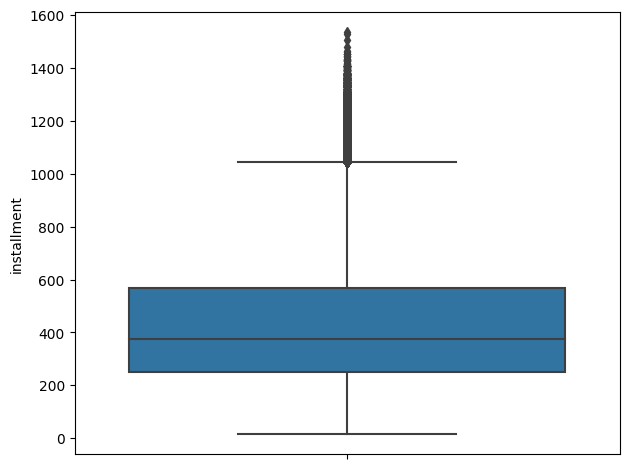

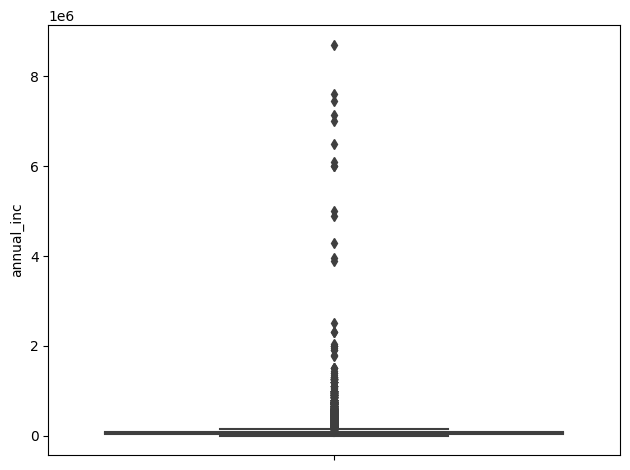

...

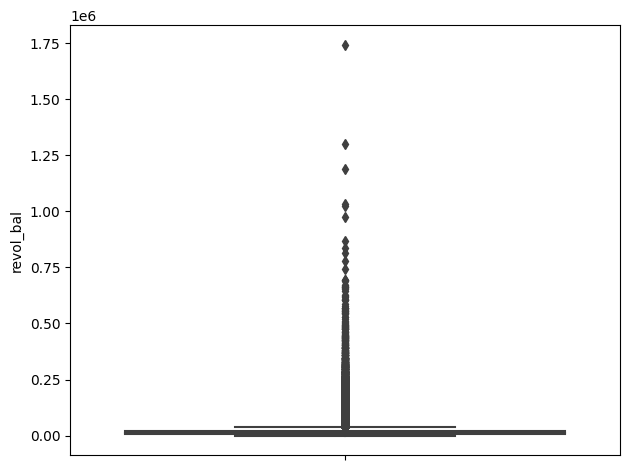

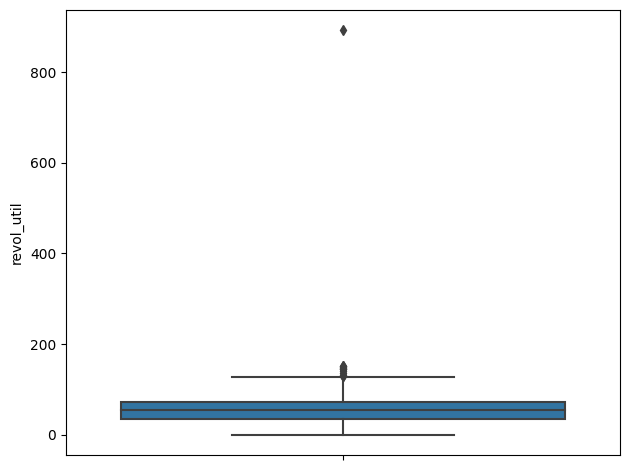

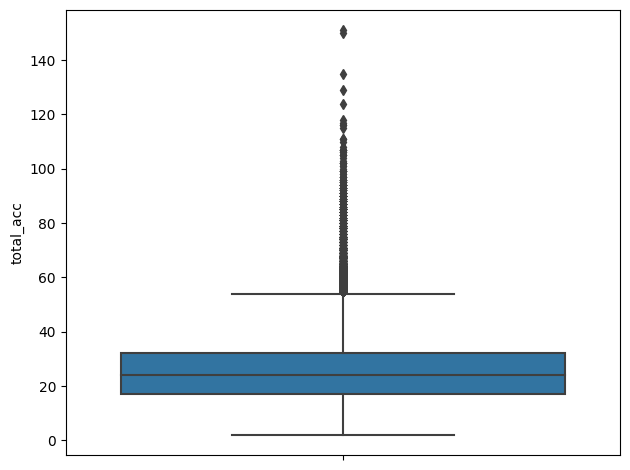

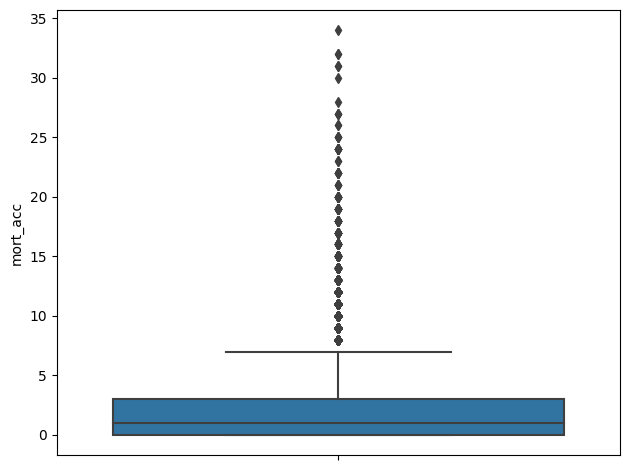

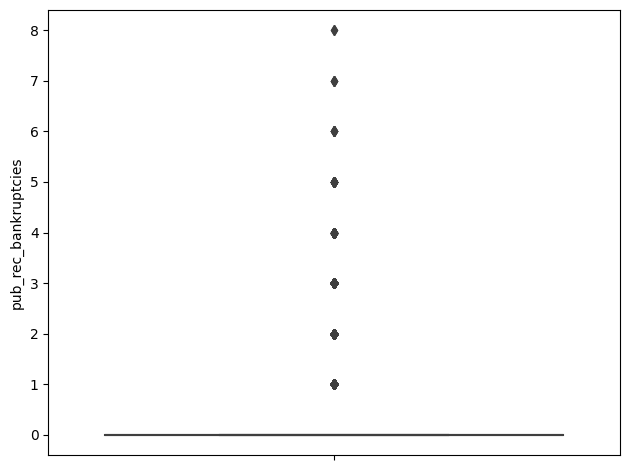

In [8]:
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

for col in numeric_columns:
    sns.boxplot(y=df[col])
    plt.tight_layout()
    plt.show()

In [9]:
# print('df size previously:', df.shape)
# numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns

# for col in numerical_columns:
#     Q1 = df[col].quantile(0.25)
#     Q3 = df[col].quantile(0.75)
#     IQR = Q3 - Q1
#     whisker_width = 1.5
#     outliers = df[(df[col] < Q1 - whisker_width * IQR) | (df[col] > Q3 + whisker_width * IQR)]
#     df = df.drop(outliers.index)

# print('df size after outlier removal:', df.shape)

The code above was to remove the oulier value rows but that may affect the further model training process. We can replac the same with median or mean instead.

In [10]:
print('df size previously:', df.shape)

numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns

for col in numerical_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    whisker_width = 1.5

    # Identify outliers
    outliers = df[(df[col] < Q1 - whisker_width * IQR) | (df[col] > Q3 + whisker_width * IQR)]

    # Impute outliers with the median of the column
    median = df[col].median()
    df.loc[outliers.index, col] = median
print('df size after outlier removal:', df.shape)

df size previously: (396030, 27)
df size after outlier removal: (396030, 27)


In [11]:
df['home_ownership'].value_counts()

MORTGAGE    198348
RENT        159790
OWN          37746
OTHER          112
NONE            31
ANY              3
Name: home_ownership, dtype: int64

In [12]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df['home_ownership'] = le.fit_transform(df['home_ownership'])
df['home_ownership'].value_counts()

1    198348
5    159790
4     37746
3       112
2        31
0         3
Name: home_ownership, dtype: int64

In [13]:
print(df['verification_status'].value_counts())
df['verification_status'] = le.fit_transform(df['verification_status'])
df['verification_status'].value_counts()
print(df['verification_status'].value_counts())

Verified           139563
Source Verified    131385
Not Verified       125082
Name: verification_status, dtype: int64
2    139563
1    131385
0    125082
Name: verification_status, dtype: int64


In [14]:
print(df['issue_d'].value_counts())
df[['Issued_month', 'Issued_year']] = df['issue_d'].str.split('-', expand=True)
df.drop(columns=['issue_d'], inplace=True)

Oct-2014    14846
Jul-2014    12609
Jan-2015    11705
Dec-2013    10618
Nov-2013    10496
            ...  
Jul-2007       26
Sep-2008       25
Nov-2007       22
Sep-2007       15
Jun-2007        1
Name: issue_d, Length: 115, dtype: int64


In [15]:
print(df['Issued_month'].value_counts())
month_mapping = {'Jan': 1, 'Feb': 2, 'Mar': 3, 'Apr': 4, 'May': 5, 'Jun': 6, 'Jul': 7, 'Aug': 8, 'Sep': 9, 'Oct': 10, 'Nov': 11, 'Dec': 12}
# Use map to encode month names
df['Issued_month'] = df['Issued_month'].map(month_mapping)
print(df['Issued_month'].value_counts())

Oct    42130
Jul    39714
Jan    34682
Nov    34068
Apr    33223
Aug    32816
Mar    31919
May    31895
Jun    30140
Dec    29082
Feb    28742
Sep    27619
Name: Issued_month, dtype: int64
10    42130
7     39714
1     34682
11    34068
4     33223
8     32816
3     31919
5     31895
6     30140
12    29082
2     28742
9     27619
Name: Issued_month, dtype: int64


In [16]:
print(df['Issued_year'].value_counts())

2014    102860
2013     97662
2015     94264
2012     41202
2016     28088
2011     17435
2010      9258
2009      3826
2008      1240
2007       195
Name: Issued_year, dtype: int64


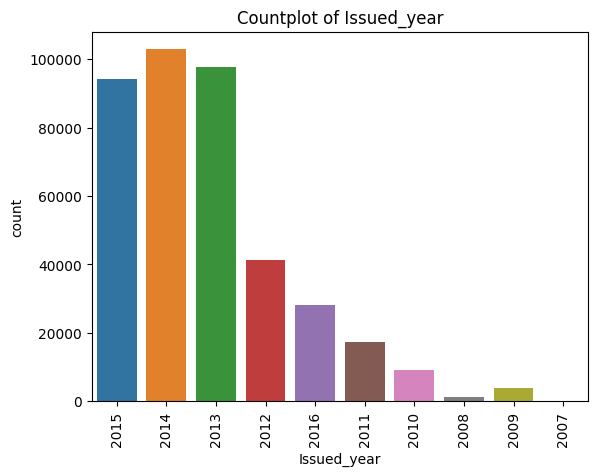

In [17]:
sns.countplot(data=df, x=df['Issued_year'])
plt.title('Countplot of Issued_year')
plt.xticks(rotation=90)
plt.show()

In [18]:
print(df['loan_status'].value_counts())
le = LabelEncoder()
df['loan_status'] = le.fit_transform(df['loan_status'])
print(df['loan_status'].value_counts())

Fully Paid     318357
Charged Off     77673
Name: loan_status, dtype: int64
1    318357
0     77673
Name: loan_status, dtype: int64


debt_consolidation    234507
credit_card            83019
home_improvement       24030
other                  21185
major_purchase          8790
small_business          5701
car                     4697
medical                 4196
moving                  2854
vacation                2452
house                   2201
wedding                 1812
renewable_energy         329
educational              257
Name: purpose, dtype: int64


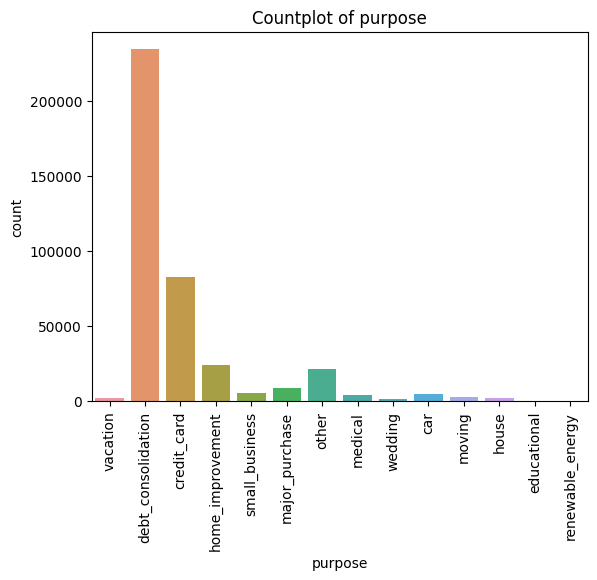

2     234507
1      83019
4      24030
9      21185
6       8790
11      5701
0       4697
7       4196
8       2854
12      2452
5       2201
13      1812
10       329
3        257
Name: purpose, dtype: int64


In [19]:
print(df['purpose'].value_counts())

sns.countplot(data=df, x=df['purpose'])
plt.title('Countplot of purpose')
plt.xticks(rotation=90)
plt.show()

le = LabelEncoder()
df['purpose'] = le.fit_transform(df['purpose'])
print(df['purpose'].value_counts())

The above are some features whoch have many datapoints & the same canot be label incoded. We would need to use a better engineering technique to treate these features.

0.0    396030
Name: pub_rec, dtype: int64


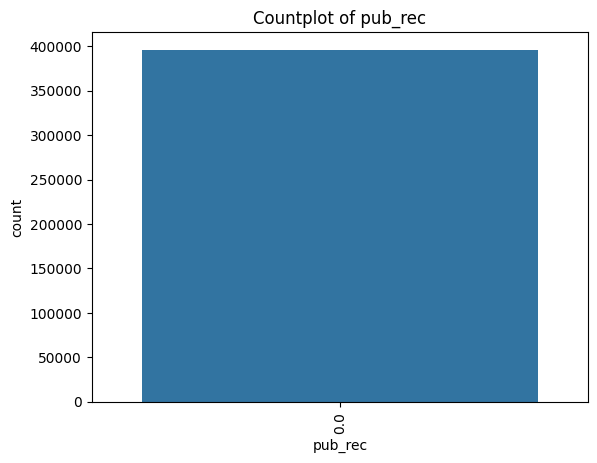

0    396030
Name: pub_rec, dtype: int64


In [20]:
print(df['pub_rec'].value_counts())

sns.countplot(data=df, x=df['pub_rec'])
plt.title('Countplot of pub_rec')
plt.xticks(rotation=90)
plt.show()

le = LabelEncoder()
df['pub_rec'] = le.fit_transform(df['pub_rec'])
print(df['pub_rec'].value_counts())

f    238066
w    157964
Name: initial_list_status, dtype: int64
2


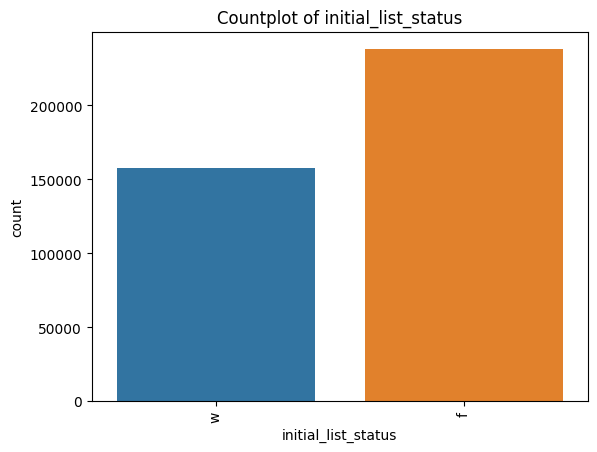

0    238066
1    157964
Name: initial_list_status, dtype: int64


In [21]:
print(df['initial_list_status'].value_counts()), print(df['initial_list_status'].nunique())

sns.countplot(data=df, x=df['initial_list_status'])
plt.title('Countplot of initial_list_status')
plt.xticks(rotation=90)
plt.show()

le = LabelEncoder()
df['initial_list_status'] = le.fit_transform(df['initial_list_status'])
print(df['initial_list_status'].value_counts())

INDIVIDUAL    395319
JOINT            425
DIRECT_PAY       286
Name: application_type, dtype: int64
3


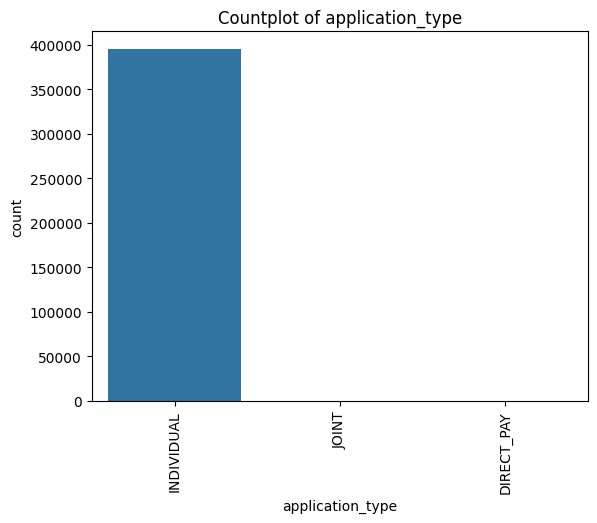

1    395319
2       425
0       286
Name: application_type, dtype: int64


In [22]:
print(df['application_type'].value_counts()), print(df['application_type'].nunique())

sns.countplot(data=df, x=df['application_type'])
plt.title('Countplot of application_type')
plt.xticks(rotation=90)
plt.show()

le = LabelEncoder()
df['application_type'] = le.fit_transform(df['application_type'])
print(df['application_type'].value_counts())

In [23]:
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address,Issued_month,Issued_year
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,36369.0,41.8,25.0,1,1,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690",1,2015
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,20131.0,53.3,27.0,0,1,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113",1,2015


Address can again be worked out & splitted based on country & state.

In [24]:
print(df['address'].value_counts()), print(df['address'].nunique())

USCGC Smith\r\nFPO AE 70466                           8
USS Johnson\r\nFPO AE 48052                           8
USNS Johnson\r\nFPO AE 05113                          8
USS Smith\r\nFPO AP 70466                             8
USNS Johnson\r\nFPO AP 48052                          7
                                                     ..
455 Tricia Cove\r\nAustinbury, FL 00813               1
7776 Flores Fall\r\nFernandezshire, UT 05113          1
6577 Mia Harbors Apt. 171\r\nRobertshire, OK 22690    1
8141 Cox Greens Suite 186\r\nMadisonstad, VT 05113    1
787 Michelle Causeway\r\nBriannaton, AR 48052         1
Name: address, Length: 393700, dtype: int64
393700


(None, None)

In [25]:
df['address'][0:5]

0       0174 Michelle Gateway\r\nMendozaberg, OK 22690
1    1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113
2    87025 Mark Dale Apt. 269\r\nNew Sabrina, WV 05113
3              823 Reid Ford\r\nDelacruzside, MA 00813
4               679 Luna Roads\r\nGreggshire, VA 11650
Name: address, dtype: object

In [26]:
df1 = pd.concat([df["address"].str.split("\r\n", expand=True)], axis=1)
df = df.join(df1)
df.drop(columns=['address'], inplace=True)

In [27]:
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,0,1
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,41.8,25.0,1,1,0.0,0.0,1,2015,0174 Michelle Gateway,"Mendozaberg, OK 22690"
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,53.3,27.0,0,1,3.0,0.0,1,2015,1076 Carney Fort Apt. 347,"Loganmouth, SD 05113"


In [28]:
df = pd.melt(df,
            id_vars = [           'loan_amnt',                 'term',             'int_rate',
                'installment',                'grade',            'sub_grade',
                  'emp_title',           'emp_length',       'home_ownership',
                 'annual_inc',  'verification_status',          'loan_status',
                    'purpose',                'title',                  'dti',
           'earliest_cr_line',             'open_acc',              'pub_rec',
                  'revol_bal',           'revol_util',            'total_acc',
        'initial_list_status',     'application_type',             'mort_acc',
       'pub_rec_bankruptcies',         'Issued_month',          'Issued_year', 1],
             value_name = 'Address')


In [29]:
df.head(5)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,1,variable,Address
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,25.0,1,1,0.0,0.0,1,2015,"Mendozaberg, OK 22690",0,0174 Michelle Gateway
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,27.0,0,1,3.0,0.0,1,2015,"Loganmouth, SD 05113",0,1076 Carney Fort Apt. 347
2,15600.0,3.0,10.49,506.97,B,B3,Statistician,< 1 year,5,43057.0,...,26.0,0,1,0.0,0.0,1,2015,"New Sabrina, WV 05113",0,87025 Mark Dale Apt. 269
3,7200.0,3.0,6.49,220.65,A,A2,Client Advocate,6 years,5,54000.0,...,13.0,0,1,0.0,0.0,11,2014,"Delacruzside, MA 00813",0,823 Reid Ford
4,24375.0,3.0,17.27,609.33,C,C5,Destiny Management Inc.,9 years,1,55000.0,...,43.0,0,1,1.0,0.0,4,2013,"Greggshire, VA 11650",0,679 Luna Roads


In [30]:
df.drop(columns=['Address'], inplace=True)
df.drop(columns=['variable'], inplace=True)

In [31]:
df.columns

Index([           'loan_amnt',                 'term',             'int_rate',
                'installment',                'grade',            'sub_grade',
                  'emp_title',           'emp_length',       'home_ownership',
                 'annual_inc',  'verification_status',          'loan_status',
                    'purpose',                'title',                  'dti',
           'earliest_cr_line',             'open_acc',              'pub_rec',
                  'revol_bal',           'revol_util',            'total_acc',
        'initial_list_status',     'application_type',             'mort_acc',
       'pub_rec_bankruptcies',         'Issued_month',          'Issued_year',
                            1],
      dtype='object')

In [32]:
df = df.rename(columns={1: 'Address'})
df

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,Address
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,36369.0,41.8,25.0,1,1,0.0,0.0,1,2015,"Mendozaberg, OK 22690"
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,20131.0,53.3,27.0,0,1,3.0,0.0,1,2015,"Loganmouth, SD 05113"
2,15600.0,3.0,10.49,506.97,B,B3,Statistician,< 1 year,5,43057.0,...,11987.0,92.2,26.0,0,1,0.0,0.0,1,2015,"New Sabrina, WV 05113"
3,7200.0,3.0,6.49,220.65,A,A2,Client Advocate,6 years,5,54000.0,...,5472.0,21.5,13.0,0,1,0.0,0.0,11,2014,"Delacruzside, MA 00813"
4,24375.0,3.0,17.27,609.33,C,C5,Destiny Management Inc.,9 years,1,55000.0,...,24584.0,69.8,43.0,0,1,1.0,0.0,4,2013,"Greggshire, VA 11650"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396025,10000.0,3.0,10.99,217.38,B,B4,licensed bankere,2 years,5,40000.0,...,1990.0,34.3,23.0,1,1,0.0,0.0,10,2015,"Johnnyville, DC 30723"
396026,21000.0,3.0,12.29,700.42,C,C1,Agent,5 years,1,110000.0,...,11181.0,95.7,8.0,0,1,1.0,0.0,2,2015,"Rachelborough, LA 05113"
396027,5000.0,3.0,9.99,161.32,B,B1,City Carrier,10+ years,5,56500.0,...,32704.0,66.9,23.0,0,1,0.0,0.0,10,2013,"Reedfort, NY 70466"
396028,21000.0,3.0,15.31,503.02,C,C2,"Gracon Services, Inc",10+ years,1,64000.0,...,15704.0,53.8,20.0,0,1,5.0,0.0,8,2012,"New Michael, FL 29597"


In [33]:
df1 = pd.concat([df["Address"].str.split(",", expand=True)], axis=1)
df = df.join(df1)
df.drop(columns=['Address'], inplace=True)

In [34]:
df = df.rename(columns={0: 'City', 1: 'State'})
df

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,41.8,25.0,1,1,0.0,0.0,1,2015,Mendozaberg,OK 22690
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,53.3,27.0,0,1,3.0,0.0,1,2015,Loganmouth,SD 05113
2,15600.0,3.0,10.49,506.97,B,B3,Statistician,< 1 year,5,43057.0,...,92.2,26.0,0,1,0.0,0.0,1,2015,New Sabrina,WV 05113
3,7200.0,3.0,6.49,220.65,A,A2,Client Advocate,6 years,5,54000.0,...,21.5,13.0,0,1,0.0,0.0,11,2014,Delacruzside,MA 00813
4,24375.0,3.0,17.27,609.33,C,C5,Destiny Management Inc.,9 years,1,55000.0,...,69.8,43.0,0,1,1.0,0.0,4,2013,Greggshire,VA 11650
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396025,10000.0,3.0,10.99,217.38,B,B4,licensed bankere,2 years,5,40000.0,...,34.3,23.0,1,1,0.0,0.0,10,2015,Johnnyville,DC 30723
396026,21000.0,3.0,12.29,700.42,C,C1,Agent,5 years,1,110000.0,...,95.7,8.0,0,1,1.0,0.0,2,2015,Rachelborough,LA 05113
396027,5000.0,3.0,9.99,161.32,B,B1,City Carrier,10+ years,5,56500.0,...,66.9,23.0,0,1,0.0,0.0,10,2013,Reedfort,NY 70466
396028,21000.0,3.0,15.31,503.02,C,C2,"Gracon Services, Inc",10+ years,1,64000.0,...,53.8,20.0,0,1,5.0,0.0,8,2012,New Michael,FL 29597


In [35]:
df1 = pd.concat([df["State"].str.split(" ", expand=True)], axis=1)
df = df.join(df1)
df.drop(columns=['State'], inplace=True)

In [36]:
df = df.rename(columns={0: 'Annn', 1: 'State', 2: 'Zip'})
df.drop(columns=['Annn'], inplace=True)
df

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip
0,10000.0,3.0,11.44,329.48,B,B4,Marketing,10+ years,5,117000.0,...,25.0,1,1,0.0,0.0,1,2015,Mendozaberg,OK,22690
1,8000.0,3.0,11.99,265.68,B,B5,Credit analyst,4 years,1,65000.0,...,27.0,0,1,3.0,0.0,1,2015,Loganmouth,SD,05113
2,15600.0,3.0,10.49,506.97,B,B3,Statistician,< 1 year,5,43057.0,...,26.0,0,1,0.0,0.0,1,2015,New Sabrina,WV,05113
3,7200.0,3.0,6.49,220.65,A,A2,Client Advocate,6 years,5,54000.0,...,13.0,0,1,0.0,0.0,11,2014,Delacruzside,MA,00813
4,24375.0,3.0,17.27,609.33,C,C5,Destiny Management Inc.,9 years,1,55000.0,...,43.0,0,1,1.0,0.0,4,2013,Greggshire,VA,11650
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396025,10000.0,3.0,10.99,217.38,B,B4,licensed bankere,2 years,5,40000.0,...,23.0,1,1,0.0,0.0,10,2015,Johnnyville,DC,30723
396026,21000.0,3.0,12.29,700.42,C,C1,Agent,5 years,1,110000.0,...,8.0,0,1,1.0,0.0,2,2015,Rachelborough,LA,05113
396027,5000.0,3.0,9.99,161.32,B,B1,City Carrier,10+ years,5,56500.0,...,23.0,0,1,0.0,0.0,10,2013,Reedfort,NY,70466
396028,21000.0,3.0,15.31,503.02,C,C2,"Gracon Services, Inc",10+ years,1,64000.0,...,20.0,0,1,5.0,0.0,8,2012,New Michael,FL,29597


In [37]:
print(df['City'].value_counts()), print(df['City'].nunique())

APO AP 70466          757
DPO AP 70466          745
DPO AE 22690          740
FPO AE 22690          712
FPO AP 22690          708
                     ... 
East Alexandraport      1
East Dominiqueberg      1
East Briannastad        1
East Melanieland        1
North Peterville        1
Name: City, Length: 67600, dtype: int64
67600


(None, None)

NJ    7091
WI    7081
LA    7068
NV    7038
AK    7034
MA    7022
VA    7022
VT    7005
NY    7004
MS    7003
TX    7000
SC    6973
ME    6972
OH    6969
AR    6969
GA    6967
ID    6958
IN    6958
KS    6945
WV    6944
RI    6940
MO    6939
IL    6934
WY    6933
NE    6927
HI    6927
IA    6926
FL    6921
AZ    6918
CO    6914
OK    6911
MN    6904
CT    6904
NC    6901
AL    6898
OR    6898
CA    6898
MD    6896
WA    6895
SD    6887
UT    6887
MT    6883
DE    6874
TN    6869
ND    6858
MI    6854
NM    6842
DC    6842
PA    6825
NH    6818
KY    6800
Name: State, dtype: int64
51


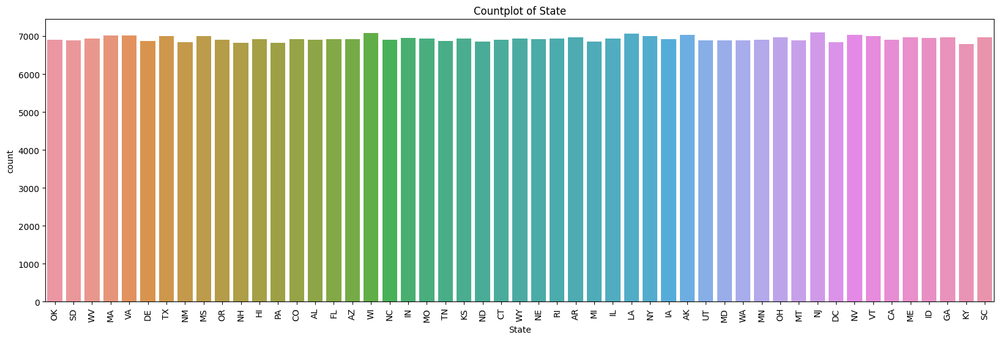

In [38]:
print(df['State'].value_counts()), print(df['State'].nunique())

plt.figure(figsize=(20, 6))
sns.countplot(data=df, x=df['State'])
plt.title('Countplot of State')
plt.xticks(rotation=90)
plt.show()

In [39]:
# print(df['title'].value_counts()), print(df['title'].nunique())
# print(df['dti'].value_counts()), print(df['title'].nunique())
# print(df['earliest_cr_line'].value_counts()), print(df['earliest_cr_line'].nunique())
# print(df['open_acc'].value_counts()), print(df['open_acc'].nunique())
# print(df['revol_bal'].value_counts()), print(df['revol_bal'].nunique())
# print(df['total_acc'].value_counts()), print(df['total_acc'].nunique())
# print(df['pub_rec_bankruptcies'].value_counts()), print(df['mort_acc'].nunique())
# print(df['City'].value_counts()), print(df['City'].nunique())
# print(df['State'].value_counts()), print(df['State'].nunique())

In [40]:
A = ['title', 'dti', 'earliest_cr_line', 'open_acc', "revol_bal", "total_acc",
     "pub_rec_bankruptcies", "City", "State", 'grade', 'sub_grade', 'emp_title', 'emp_length', 'Issued_year', 'Zip']
for i in A:
    le = LabelEncoder()
    df[i] = le.fit_transform(df[i])
    print(df[i].value_counts())

12926    152472
10159     51487
19881     15264
27676     12930
11558     11608
          ...  
18086         1
11066         1
42855         1
40696         1
36384         1
Name: title, Length: 48818, dtype: int64
1691    453
0       313
1440    310
1920    302
1680    301
       ... 
4001      1
4005      1
3919      1
4013      1
4008      1
Name: dti, Length: 4017, dtype: int64
613    3017
99     2935
614    2896
100    2884
556    2736
       ... 
290       1
514       1
227       1
289       1
58        1
Name: earliest_cr_line, Length: 684, dtype: int64
10    45748
9     36779
8     35137
11    32695
7     31328
12    29157
6     25927
13    24983
14    21173
5     18308
15    17347
16    14376
17    11618
4     10709
18     9430
19     7723
20     5973
3      4783
21     4650
22     3692
23     2944
2      1459
1        85
0         6
Name: open_acc, dtype: int64
11181    21281
0         2128
5655        41
7792        38
6095        38
         ...  
30275        1
35740    

In [41]:
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip
0,10000.0,3.0,11.44,329.48,1,8,80956,1,5,117000.0,...,23,1,1,0.0,0,1,8,28584,36,3
1,8000.0,3.0,11.99,265.68,1,9,33317,4,1,65000.0,...,25,0,1,3.0,0,1,8,26621,41,1


In [42]:
df.shape, df.columns

((396030, 30),
 Index(['loan_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade',
        'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
        'verification_status', 'loan_status', 'purpose', 'title', 'dti',
        'earliest_cr_line', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
        'total_acc', 'initial_list_status', 'application_type', 'mort_acc',
        'pub_rec_bankruptcies', 'Issued_month', 'Issued_year', 'City', 'State',
        'Zip'],
       dtype='object'))

In [43]:
for i in df.columns:
  print(i, " : ", df[i].nunique()), print(df[i].dtypes)
  print(df[i].value_counts())
  print('*'*20)

loan_amnt  :  1385
float64
10000.0    27668
12000.0    21557
15000.0    19903
20000.0    18969
35000.0    14576
           ...  
37450.0        1
35525.0        1
700.0          1
32575.0        1
725.0          1
Name: loan_amnt, Length: 1385, dtype: int64
********************
term  :  1
float64
3.0    396030
Name: term, dtype: int64
********************
int_rate  :  524
float64
10.99    12411
12.99     9632
15.61     9350
11.99     8582
8.90      8019
         ...  
14.28        1
22.94        1
18.72        1
18.36        1
24.59        1
Name: int_rate, Length: 524, dtype: int64
********************
installment  :  53615
float64
375.43    11543
327.34      968
332.10      791
491.01      736
336.90      686
          ...  
411.06        1
681.89        1
105.25        1
45.78         1
572.44        1
Name: installment, Length: 53615, dtype: int64
********************
grade  :  7
int64
1    116018
2    105987
0     64187
3     63524
4     31488
5     11772
6      3054
Name: grade, 

In [44]:
cat_cols=df.dtypes=="object"
cat_cols=list(cat_cols[cat_cols].index)
cat_cols
# for column in df.columns:
#     if df[column].dtype == 'object':
#         sns.countplot(data=df, x=column)
#         plt.title(f'Countplot of {column}')
#         plt.show()

[]

In [45]:
# elements_to_remove = ["emp_length", "emp_title", "issue_d", "title", "earliest_cr_line", "address"] ##Removing the columns that has too many values.
# cat_cols = [col for col in cat_cols if col not in elements_to_remove]
# cat_cols

In [46]:
for column in cat_cols:
    value_counts = df[column].value_counts().sort_index()
    sns.countplot(data=df, x=column, order=value_counts.index)
    plt.title(f'Countplot of {column}')
    plt.xticks(rotation=90)
    plt.show()

In [47]:
for i in df:
  print(i , ': ', df[i].describe(include = 'all'))
  print('***********')

loan_amnt :  count    396030.000000
mean      14100.413542
std        8338.291746
min         500.000000
25%        8000.000000
50%       12000.000000
75%       20000.000000
max       38000.000000
Name: loan_amnt, dtype: float64
***********
term :  count    396030.0
mean          3.0
std           0.0
min           3.0
25%           3.0
50%           3.0
75%           3.0
max           3.0
Name: term, dtype: float64
***********
int_rate :  count    396030.000000
mean         13.515068
std           4.293015
min           5.320000
25%          10.490000
50%          13.330000
75%          16.290000
max          25.440000
Name: int_rate, dtype: float64
***********
installment :  count    396030.000000
mean        409.232743
std         216.156930
min          16.080000
25%         250.330000
50%         375.430000
75%         538.990000
max        1042.730000
Name: installment, dtype: float64
***********
grade :  count    396030.000000
mean          1.822337
std           1.333809
min   

In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396030 entries, 0 to 396029
Data columns (total 30 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             396030 non-null  float64
 1   term                  396030 non-null  float64
 2   int_rate              396030 non-null  float64
 3   installment           396030 non-null  float64
 4   grade                 396030 non-null  int64  
 5   sub_grade             396030 non-null  int64  
 6   emp_title             396030 non-null  int64  
 7   emp_length            396030 non-null  int64  
 8   home_ownership        396030 non-null  int64  
 9   annual_inc            396030 non-null  float64
 10  verification_status   396030 non-null  int64  
 11  loan_status           396030 non-null  int64  
 12  purpose               396030 non-null  int64  
 13  title                 396030 non-null  int64  
 14  dti                   396030 non-null  int64  
 15  

In [49]:
df["loan_status"]

0         1
1         1
2         1
3         1
4         0
         ..
396025    1
396026    1
396027    1
396028    1
396029    1
Name: loan_status, Length: 396030, dtype: int64

In [50]:
A = round(df.isna().sum()/df.shape[0]*100, 2)
A = A.sort_values(ascending = False)
A

mort_acc                9.54
revol_util              0.07
loan_amnt               0.00
term                    0.00
State                   0.00
City                    0.00
Issued_year             0.00
Issued_month            0.00
pub_rec_bankruptcies    0.00
application_type        0.00
initial_list_status     0.00
total_acc               0.00
revol_bal               0.00
pub_rec                 0.00
open_acc                0.00
earliest_cr_line        0.00
dti                     0.00
title                   0.00
purpose                 0.00
loan_status             0.00
verification_status     0.00
annual_inc              0.00
home_ownership          0.00
emp_length              0.00
emp_title               0.00
sub_grade               0.00
grade                   0.00
installment             0.00
int_rate                0.00
Zip                     0.00
dtype: float64

In [51]:
!pip install pandas-profiling
from pandas_profiling import ProfileReport

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 33.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 11.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 33.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 23.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 57.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=d2d508425cc3bc1bbb293361ca300a6ad578a1c33a9a7ef0194a4d23aa9e9bb0
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


<ipython-input-51-ade3b97f5e0d>:2: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [52]:
profile = ProfileReport(df, title='Pandas Profiling Report',
                        html={'style': {'full_width': True}},
                        explorative=True)
profile.to_file("report.html")
profile.to_widgets()  ### Herein we can togle between the tabs to have a look into the data profile reports & infer the details.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pandas_profiling/profile_report.py:457: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [53]:
###Additional codes to display the dashboard
from IPython.display import HTML
html_file_path = "/content/report.html"

with open(html_file_path, "r") as html_file:
    html_content = html_file.read()

display(HTML(html_content))

Number of variables,30
Number of observations,396030
Missing cells,38071
Missing cells (%),0.3%
Duplicate rows,0
Duplicate rows (%),0.0%
Total size in memory,90.6 MiB
Average record size in memory,240.0 B
Numeric,23
Categorical,7
"term has constant value ""3.0""",Constant


In [ ]:
# Loop through each column and fill null values with the median for numeric columns and mode for non-numeric columns
for column in df.columns:
    if pd.api.types.is_numeric_dtype(df[column]):
        median = df[column].median()
        df[column].fillna(median, inplace=True)
    else:
        mode = df[column].mode().iloc[0]
        df[column].fillna(mode, inplace=True)

In [ ]:
A = round(df.isna().sum()/df.shape[0]*100, 2)
A = A.sort_values(ascending = False)
A

loan_amnt               0.0
term                    0.0
State                   0.0
City                    0.0
Issued_year             0.0
Issued_month            0.0
pub_rec_bankruptcies    0.0
mort_acc                0.0
application_type        0.0
initial_list_status     0.0
total_acc               0.0
revol_util              0.0
revol_bal               0.0
pub_rec                 0.0
open_acc                0.0
earliest_cr_line        0.0
dti                     0.0
title                   0.0
purpose                 0.0
loan_status             0.0
verification_status     0.0
annual_inc              0.0
home_ownership          0.0
emp_length              0.0
emp_title               0.0
sub_grade               0.0
grade                   0.0
installment             0.0
int_rate                0.0
Zip                     0.0
dtype: float64

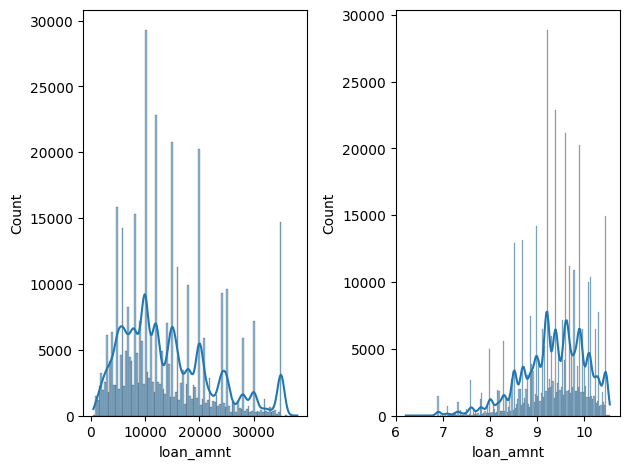

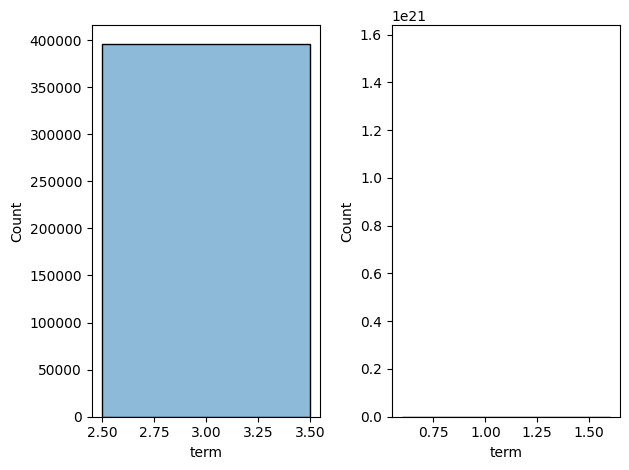

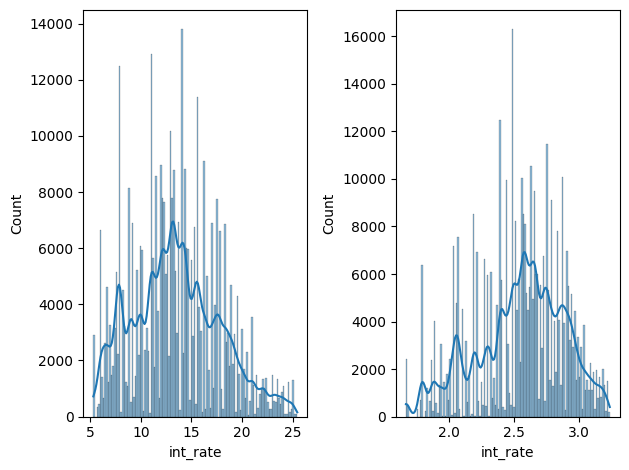

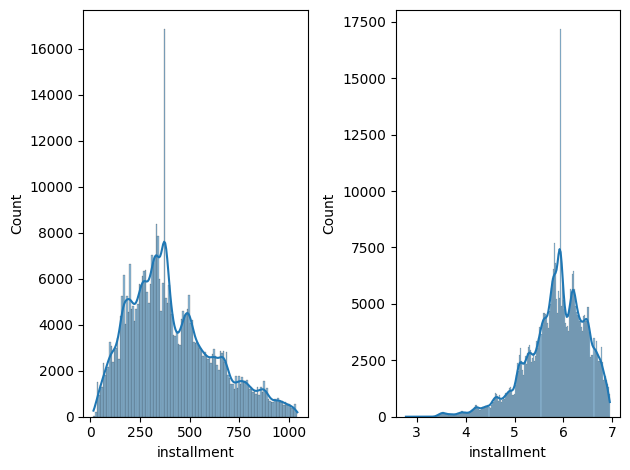

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


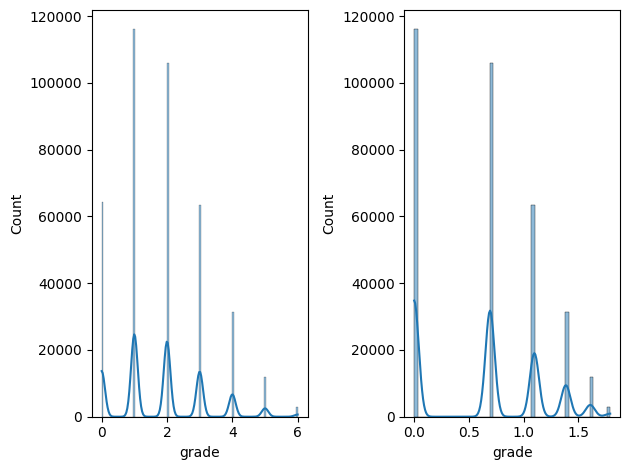

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


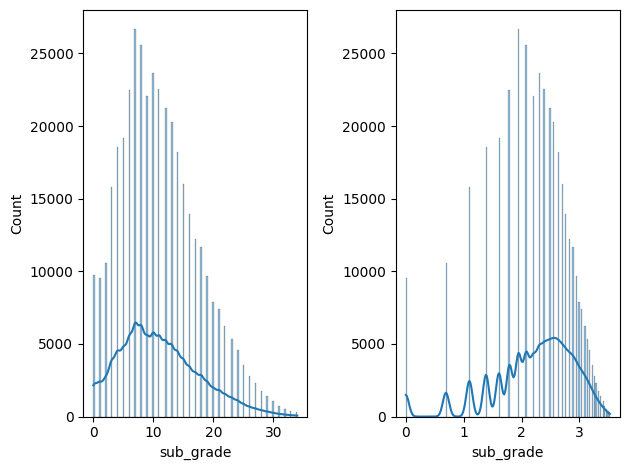

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


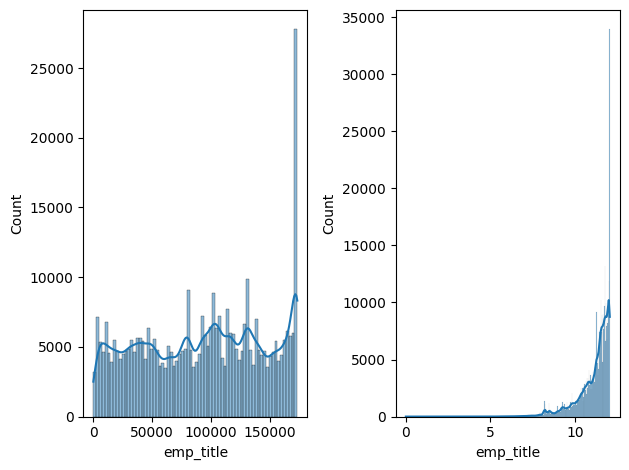

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


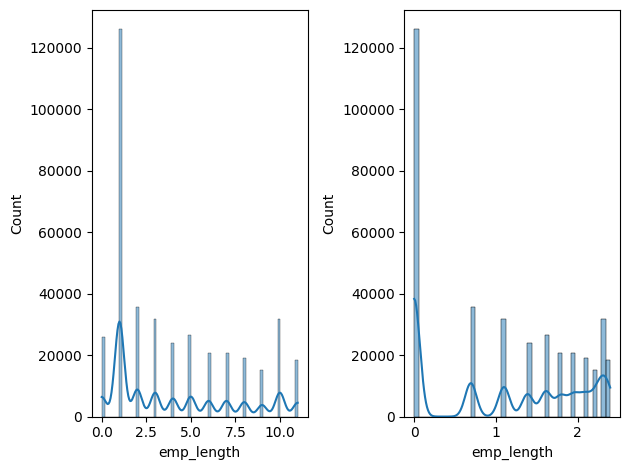

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


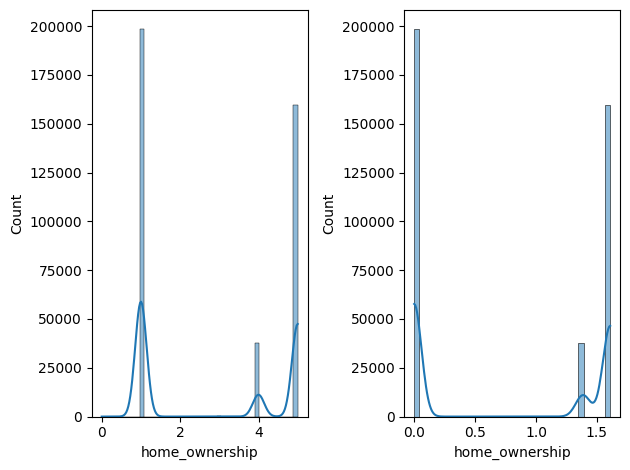

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


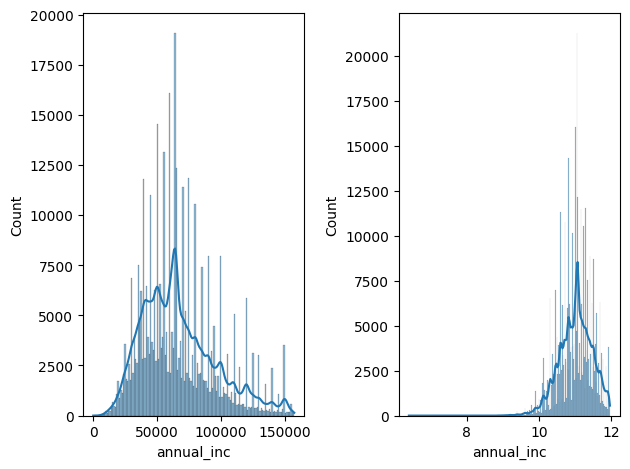

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


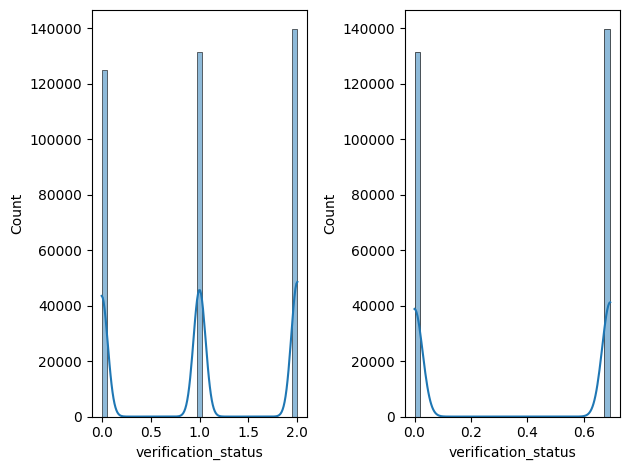

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


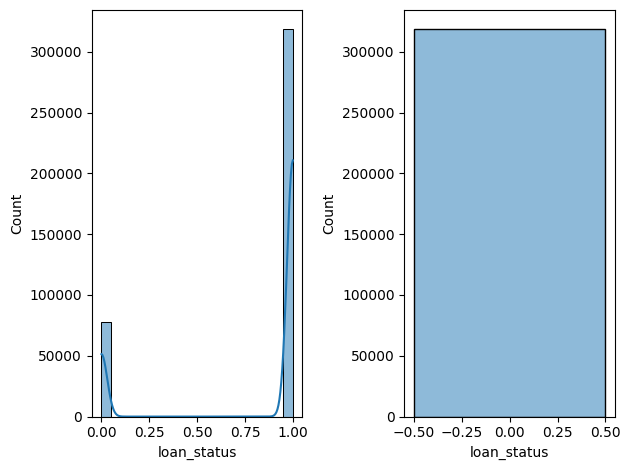

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


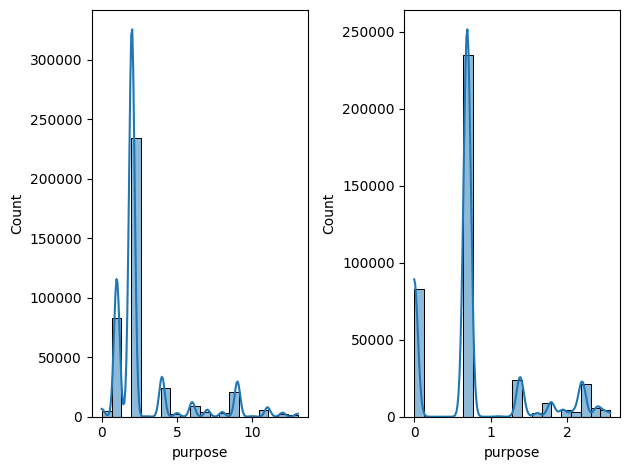

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


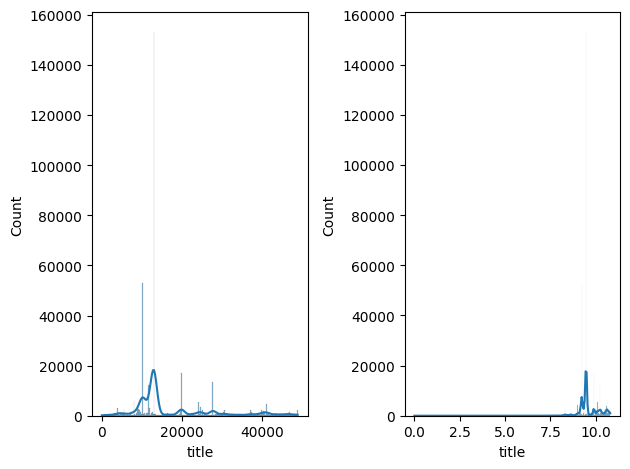

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


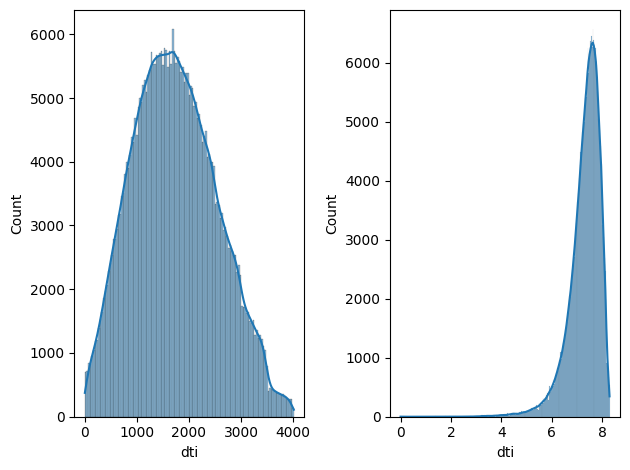

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


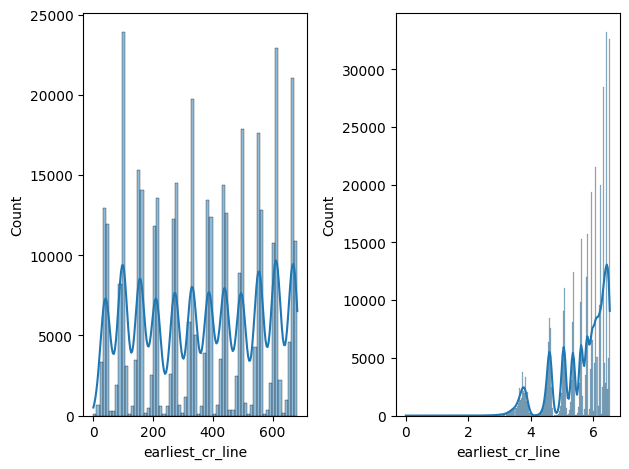

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


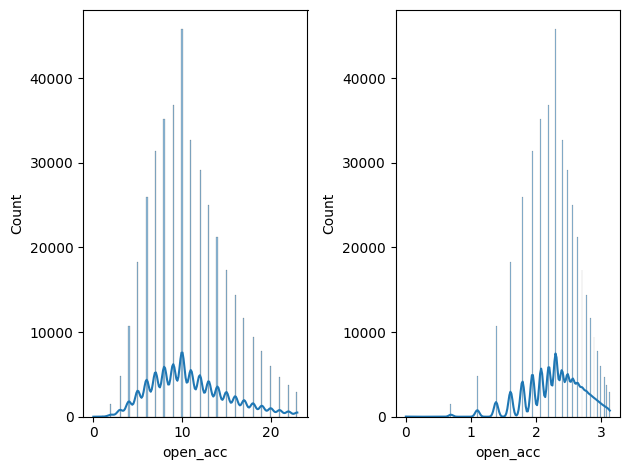

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


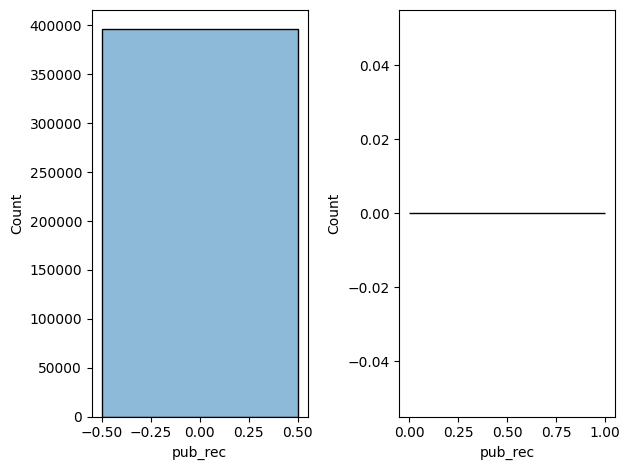

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


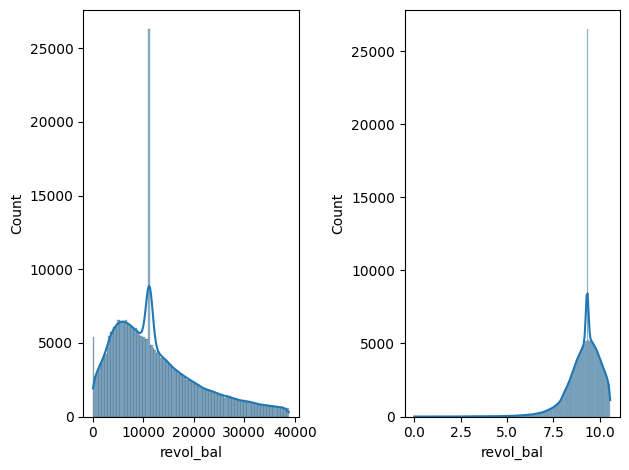

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


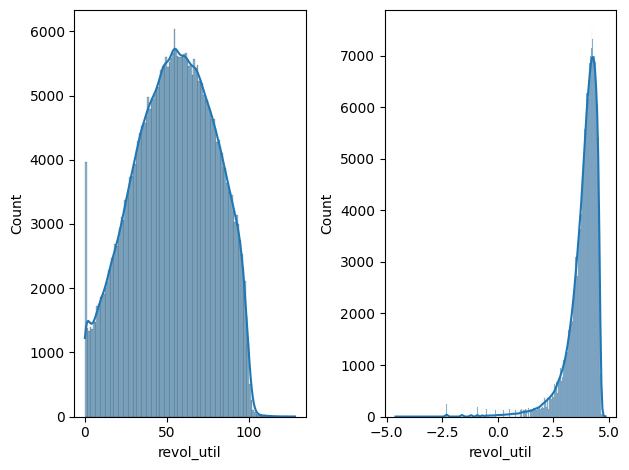

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


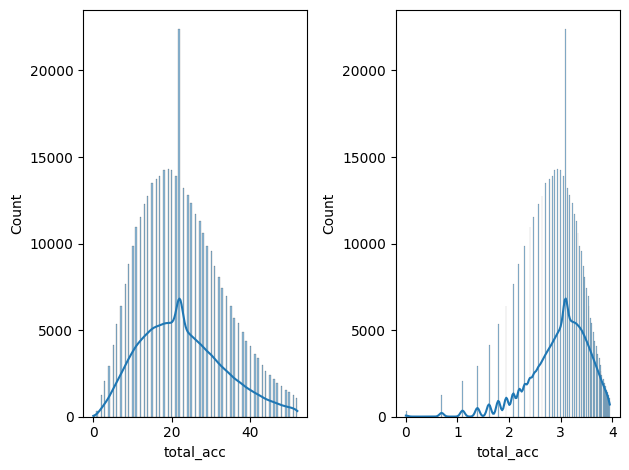

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


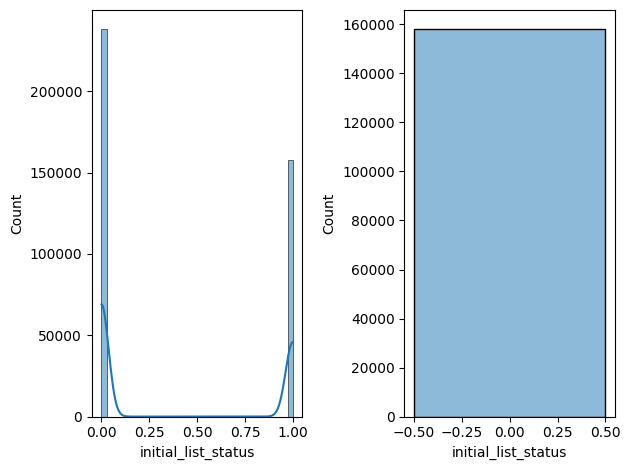

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


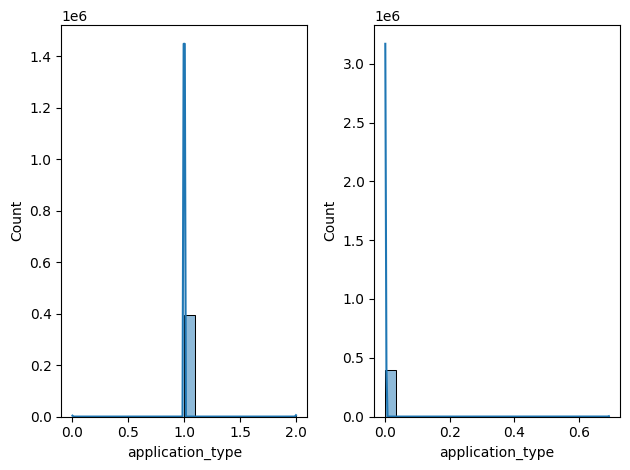

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


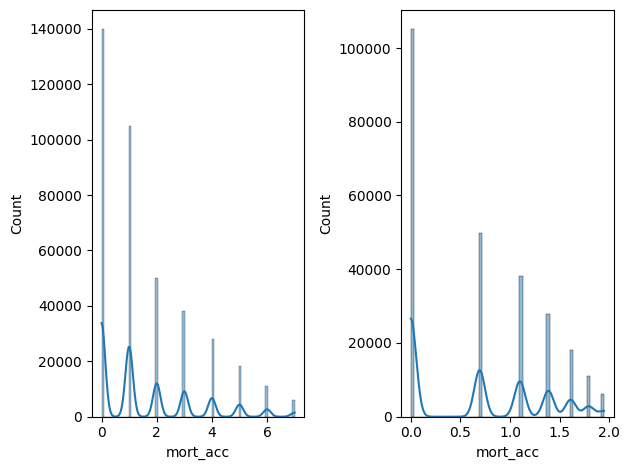

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


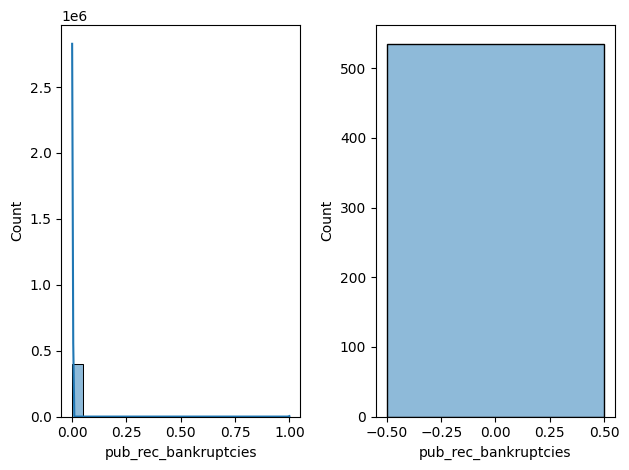

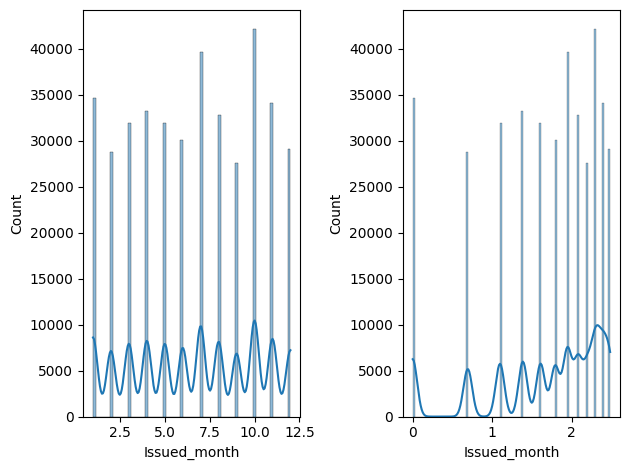

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


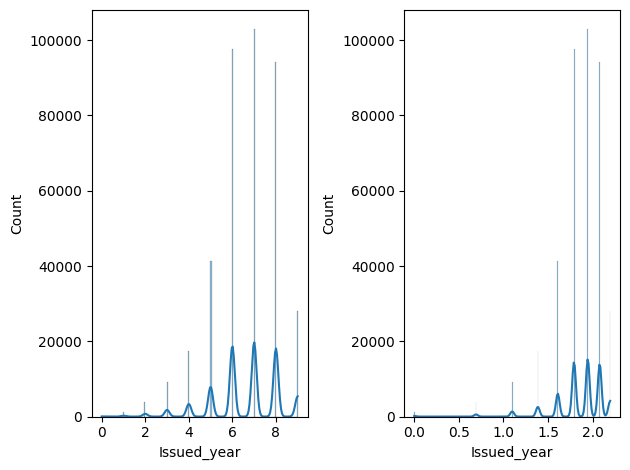

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


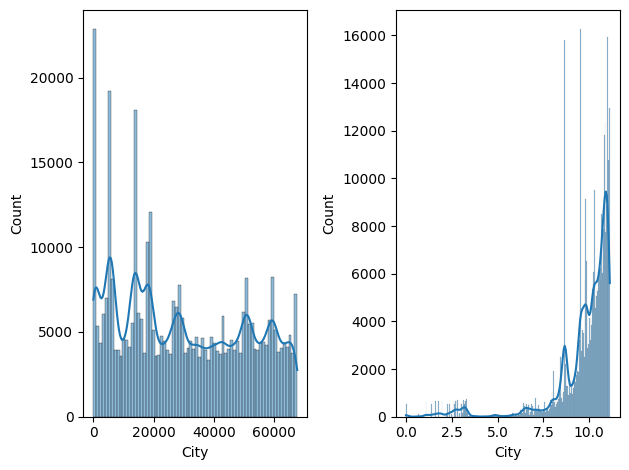

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


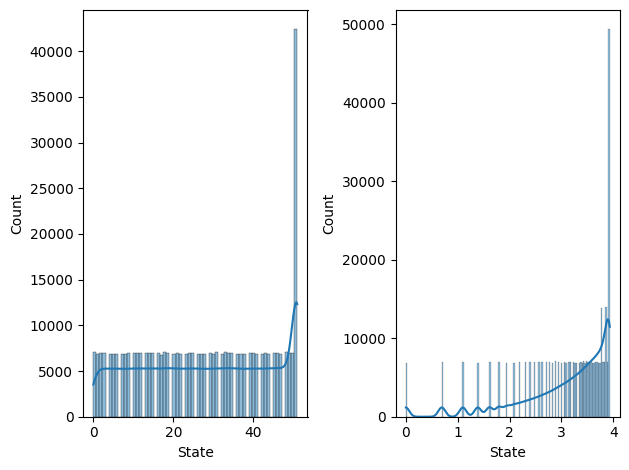

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


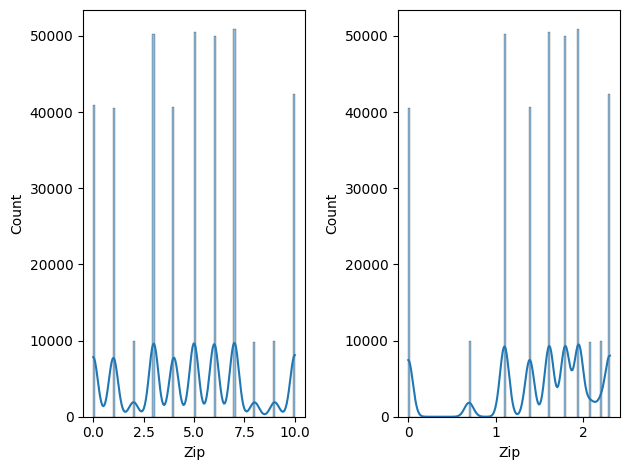

In [ ]:
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

for col in numeric_columns:
  plt.subplot(121)
  sns.histplot(df[col], kde=True)

  plt.subplot(122)
  sns.histplot(np.log(df[col]), kde=True)

  plt.tight_layout()
  plt.show()

In [ ]:
from scipy.stats import shapiro
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

gaussian_columns = []
nongaussian_columns = []
for col in numeric_columns:
    stat, p = shapiro(df[col])
    print('\nColumn:', col)
    print('stat=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        gaussian_columns.append(col)
    else:
        nongaussian_columns.append(col)

print("Columns with Gaussian distributions:", gaussian_columns)
print("Columns with non-Gaussian distributions:", nongaussian_columns)

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1879: UserWarning: Input data for shapiro has range zero. The results may not be accurate.
  warnings.warn("Input data for shapiro has range zero. The results "



Column: loan_amnt
stat=0.939, p=0.000

Column: term
stat=1.000, p=1.000

Column: int_rate
stat=0.984, p=0.000

Column: installment
stat=0.960, p=0.000

Column: grade
stat=0.915, p=0.000

Column: sub_grade
stat=0.968, p=0.000

Column: emp_title
stat=0.950, p=0.000

Column: emp_length
stat=0.863, p=0.000

Column: home_ownership
stat=0.679, p=0.000

Column: annual_inc
stat=0.955, p=0.000

Column: verification_status
stat=0.795, p=0.000

Column: loan_status
stat=0.484, p=0.000

Column: purpose
stat=0.614, p=0.000

Column: title
stat=0.786, p=0.000

Column: dti
stat=0.990, p=0.000

Column: earliest_cr_line
stat=0.941, p=0.000

Column: open_acc
stat=0.970, p=0.000

Column: pub_rec
stat=1.000, p=1.000

Column: revol_bal
stat=0.927, p=0.000

Column: revol_util
stat=0.983, p=0.000

Column: total_acc
stat=0.980, p=0.000

Column: initial_list_status
stat=0.622, p=0.000

Column: application_type
stat=0.021, p=0.000

Column: mort_acc
stat=0.827, p=0.000

Column: pub_rec_bankruptcies
stat=0.015, p=

In [ ]:
data = df
for col in gaussian_columns:
    data[col] = np.log(data[col])
data

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip
0,10000.0,1.098612,11.44,329.48,1,8,80956,1,5,117000.0,...,23,1,1,0.0,0,1,8,28584,36,3
1,8000.0,1.098612,11.99,265.68,1,9,33317,4,1,65000.0,...,25,0,1,3.0,0,1,8,26621,41,1
2,15600.0,1.098612,10.49,506.97,1,7,127182,10,5,43057.0,...,24,0,1,0.0,0,1,8,34634,49,1
3,7200.0,1.098612,6.49,220.65,0,1,27760,6,5,54000.0,...,11,0,1,0.0,0,11,7,6299,19,0
4,24375.0,1.098612,17.27,609.33,2,14,38300,9,1,55000.0,...,41,0,1,1.0,0,4,6,15388,45,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396025,10000.0,1.098612,10.99,217.38,1,8,160365,2,5,40000.0,...,21,1,1,0.0,0,10,8,18348,7,5
396026,21000.0,1.098612,12.29,700.42,2,10,5779,5,1,110000.0,...,6,0,1,1.0,0,2,8,49542,18,1
396027,5000.0,1.098612,9.99,161.32,1,5,26146,1,5,56500.0,...,21,0,1,0.0,0,10,6,49796,34,7
396028,21000.0,1.098612,15.31,503.02,2,11,56712,1,1,64000.0,...,18,0,1,5.0,0,8,5,33870,9,4


In [ ]:
from scipy.stats import shapiro
numeric_columns = data.select_dtypes(include=['int64', 'float64']).columns

gaussian_columns = []
nongaussian_columns = []
for col in numeric_columns:
    stat, p = shapiro(data[col])
    print('\nColumn:', col)
    print('stat=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        gaussian_columns.append(col)
    else:
        nongaussian_columns.append(col)

print("Columns with Gaussian distributions:", gaussian_columns)
print("Columns with non-Gaussian distributions:", nongaussian_columns)

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1879: UserWarning: Input data for shapiro has range zero. The results may not be accurate.
  warnings.warn("Input data for shapiro has range zero. The results "



Column: loan_amnt
stat=0.939, p=0.000

Column: term
stat=1.000, p=1.000

Column: int_rate
stat=0.984, p=0.000

Column: installment
stat=0.960, p=0.000

Column: grade
stat=0.915, p=0.000

Column: sub_grade
stat=0.968, p=0.000

Column: emp_title
stat=0.950, p=0.000

Column: emp_length
stat=0.863, p=0.000

Column: home_ownership
stat=0.679, p=0.000

Column: annual_inc
stat=0.955, p=0.000

Column: verification_status
stat=0.795, p=0.000

Column: loan_status
stat=0.484, p=0.000

Column: purpose
stat=0.614, p=0.000

Column: title
stat=0.786, p=0.000

Column: dti
stat=0.990, p=0.000

Column: earliest_cr_line
stat=0.941, p=0.000

Column: open_acc
stat=0.970, p=0.000

Column: pub_rec
stat=nan, p=1.000

Column: revol_bal
stat=0.927, p=0.000

Column: revol_util
stat=0.983, p=0.000


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1871: RuntimeWarning: invalid value encountered in subtract
  x = x - np.median(x)



Column: total_acc
stat=0.980, p=0.000

Column: initial_list_status
stat=0.622, p=0.000

Column: application_type
stat=0.021, p=0.000

Column: mort_acc
stat=0.827, p=0.000

Column: pub_rec_bankruptcies
stat=0.015, p=0.000

Column: Issued_month
stat=0.942, p=0.000

Column: Issued_year
stat=0.924, p=0.000

Column: City
stat=0.937, p=0.000

Column: State
stat=0.939, p=0.000

Column: Zip
stat=0.948, p=0.000
Columns with Gaussian distributions: ['term', 'pub_rec']
Columns with non-Gaussian distributions: ['loan_amnt', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title', 'emp_length', 'home_ownership', 'annual_inc', 'verification_status', 'loan_status', 'purpose', 'title', 'dti', 'earliest_cr_line', 'open_acc', 'revol_bal', 'revol_util', 'total_acc', 'initial_list_status', 'application_type', 'mort_acc', 'pub_rec_bankruptcies', 'Issued_month', 'Issued_year', 'City', 'State', 'Zip']


In [ ]:
from scipy.stats import pearsonr, ttest_ind
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

for col1 in numeric_columns:
    for col2 in numeric_columns:
        if col1 != col2:
            # Remove rows with missing values before calculating correlation
            valid_rows = df[[col1, col2]].dropna()

            if not valid_rows.empty:
                corr_coeff, _ = pearsonr(valid_rows[col1], valid_rows[col2])
                p_value = ttest_ind(valid_rows[col1], valid_rows[col2])[1]

                print(f'Correlation between {col1} and {col2}: {corr_coeff:.3f}')
                print(f'P-value for correlation test: {p_value:.3f}')

                if p_value < 0.05:
                    print('Correlation is statistically significant\n')
                else:
                    print('Correlation is not statistically significant\n')
            else:
                print(f'Not enough valid data for {col1} and {col2}\n')

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between loan_amnt and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and int_rate: 0.155
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and installment: 0.858
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and grade: 0.176
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and sub_grade: 0.183
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and emp_title: -0.045
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and emp_length: -0.070
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and home_ownership: -0.187
P-value for correlation test: 0.000
Correlation

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between loan_amnt and Issued_year: 0.113
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and City: 0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and State: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_amnt and Zip: 0.016
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and loan_amnt: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and int_rate: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and installment: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and grade: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples

Correlation between term and home_ownership: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and annual_inc: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and verification_status: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and loan_status: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and purpose: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and title: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and dti: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and earliest_cr_line: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples

Correlation between term and mort_acc: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and pub_rec_bankruptcies: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and Issued_month: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and Issued_year: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and City: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and State: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between term and Zip: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and loan_amnt: 0.155
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation betwee

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples

Correlation between int_rate and grade: 0.909
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and sub_grade: 0.930
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and emp_title: 0.024
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and emp_length: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and home_ownership: 0.079
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and annual_inc: -0.083
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and verification_status: 0.228
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and loan_status: -0.239
P-value for correlation test: 0.000
C

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between int_rate and pub_rec: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between int_rate and revol_bal: 0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and revol_util: 0.302
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and total_acc: -0.048
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and initial_list_status: -0.062
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and application_type: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and mort_acc: -0.074
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between int_rate and pub_rec_bankruptcies: -0.025
P-value for correlation

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between installment and int_rate: 0.132
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and grade: 0.141
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and sub_grade: 0.148
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and emp_title: -0.041
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and emp_length: -0.060
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and home_ownership: -0.152
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and annual_inc: 0.388
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and verification_status: 0.263
P-value for cor

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between installment and pub_rec: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between installment and revol_bal: 0.382
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and revol_util: 0.120
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and total_acc: 0.191
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and initial_list_status: 0.049
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and application_type: 0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and mort_acc: 0.172
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between installment and pub_rec_bankruptcies: -0.016
P-v

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between grade and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and int_rate: 0.909
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and installment: 0.141
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and sub_grade: 0.978
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and emp_title: 0.023
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and emp_length: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and home_ownership: 0.073
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and annual_inc: -0.065
P-value for correlation test: 0.000
Correlation is statistically significant

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between grade and application_type: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and mort_acc: -0.068
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and pub_rec_bankruptcies: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and Issued_month: -0.007
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and Issued_year: 0.106
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and City: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and State: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between grade and Zip: 0.061
P-value for correlation test: 0.000
Correlation is statistically 

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between sub_grade and emp_length: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and home_ownership: 0.076
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and annual_inc: -0.066
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and verification_status: 0.230
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and loan_status: -0.263
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and purpose: 0.133
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and title: 0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and dti: 0.176
P-value for correlation test: 0.000
C

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between sub_grade and initial_list_status: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and application_type: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and mort_acc: -0.070
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and pub_rec_bankruptcies: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and Issued_month: -0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and Issued_year: 0.106
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and City: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between sub_grade and State: -0.000
P-value for corr

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between emp_title and sub_grade: 0.024
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and emp_length: 0.127
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and home_ownership: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and annual_inc: -0.081
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and verification_status: 0.052
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and loan_status: -0.049
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and purpose: 0.022
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and title: 0.103
P-value for correlation test: 

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between emp_title and total_acc: -0.030
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and initial_list_status: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and application_type: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and mort_acc: 0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and pub_rec_bankruptcies: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and Issued_month: -0.004
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and Issued_year: 0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_title and City: -0.002
P-value for co

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between emp_length and int_rate: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and installment: -0.060
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and grade: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and sub_grade: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and emp_title: 0.127
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and home_ownership: 0.067
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and annual_inc: -0.118
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and verification_status: 0.056
P-value for correlation

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between emp_length and total_acc: -0.065
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and initial_list_status: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and application_type: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and mort_acc: -0.080
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and pub_rec_bankruptcies: 0.005
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and Issued_month: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and Issued_year: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between emp_length and City: -0.002
P-valu

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between home_ownership and grade: 0.073
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and sub_grade: 0.076
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and emp_title: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and emp_length: 0.067
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and annual_inc: -0.247
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and verification_status: -0.059
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and loan_status: -0.068
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and purpose: 

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))



Correlation between home_ownership and application_type: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and mort_acc: -0.486
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and pub_rec_bankruptcies: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and Issued_month: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and Issued_year: -0.036
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and City: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and State: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between home_ownership and Zip:

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between annual_inc and home_ownership: -0.247
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and verification_status: 0.089
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and loan_status: 0.078
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and purpose: -0.017
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and title: -0.075
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and dti: -0.167
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and earliest_cr_line: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and open_acc: 0.197
P-value for correlatio

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between annual_inc and revol_bal: 0.298
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and revol_util: 0.053
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and total_acc: 0.281
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and initial_list_status: 0.063
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and application_type: 0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and mort_acc: 0.292
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and pub_rec_bankruptcies: -0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between annual_inc and Issued_month: -0.008
P-val

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between verification_status and emp_title: 0.052
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and emp_length: 0.056
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and home_ownership: -0.059
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and annual_inc: 0.089
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and loan_status: -0.078
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and purpose: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and title: -0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between v

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between verification_status and mort_acc: 0.081
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and pub_rec_bankruptcies: -0.047
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and Issued_month: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and Issued_year: 0.029
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and City: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and State: -0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between verification_status and Zip: 0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between loan_status and emp_length: -0.031
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and home_ownership: -0.068
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and annual_inc: 0.078
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and verification_status: -0.078
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and purpose: -0.020
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and title: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and dti: -0.132
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and earliest_cr_line: 0.001
P-value for c

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between loan_status and application_type: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and mort_acc: 0.063
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and pub_rec_bankruptcies: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and Issued_month: 0.016
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and Issued_year: -0.061
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and City: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and State: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between loan_status and Zip: -0.239
P-value for correlat

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between purpose and sub_grade: 0.133
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and emp_title: 0.022
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and emp_length: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and home_ownership: 0.037
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and annual_inc: -0.017
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and verification_status: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and loan_status: -0.020
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and title: 0.333
P-value for correlation test: 0.000
Correlati

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between purpose and total_acc: -0.073
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and initial_list_status: -0.062
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and application_type: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and mort_acc: -0.042
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and pub_rec_bankruptcies: 0.027
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and Issued_month: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and Issued_year: -0.100
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between purpose and City: -0.004
P-value for correlation test:

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between title and sub_grade: 0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and emp_title: 0.103
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and emp_length: 0.007
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and home_ownership: 0.007
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and annual_inc: -0.075
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and verification_status: -0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and loan_status: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and purpose: 0.333
P-value for correlation test: 0.000
Correlation is statisti

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between title and mort_acc: -0.034
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and pub_rec_bankruptcies: 0.025
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and Issued_month: 0.042
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and Issued_year: -0.269
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and City: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and State: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between title and Zip: -0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and loan_amnt: 0.041
P-value for correlation test: 0.000
Correlation is statistically significan

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between dti and home_ownership: 0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and annual_inc: -0.167
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and verification_status: 0.115
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and loan_status: -0.132
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and purpose: -0.107
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and title: -0.066
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and earliest_cr_line: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and open_acc: 0.299
P-value for correlation test: 0.000
Correlation is statistically signifi

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between dti and Issued_month: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and Issued_year: 0.159
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and City: -0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and State: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between dti and Zip: 0.034
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and loan_amnt: -0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and int_rate: 0.001
P-value for correlation test: 0.000
Correlation is statistically signi

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between earliest_cr_line and grade: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and sub_grade: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and emp_title: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and emp_length: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and home_ownership: 0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and annual_inc: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and verification_status: -0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between earliest_cr_line and revol_bal: -0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and revol_util: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and total_acc: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and initial_list_status: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and application_type: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and mort_acc: -0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between earliest_cr_line and pub_rec_bankruptcies: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation bet

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between open_acc and int_rate: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and installment: 0.179
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and grade: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and sub_grade: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and emp_title: -0.044
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and emp_length: -0.044
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and home_ownership: -0.141
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and annual_inc: 0.197
P-value for correlation test: 0.000
Correlatio

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between open_acc and pub_rec_bankruptcies: -0.016
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and Issued_month: -0.007
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and Issued_year: 0.113
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and City: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and State: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between open_acc and Zip: 0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec and loan_amnt: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and term: nan
P-value for correlation test: nan
Correlation is not statis

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:47

Correlation between pub_rec and grade: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and sub_grade: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and emp_title: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and emp_length: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and home_ownership: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and annual_inc: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and verification_status: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and loan_status: nan
P-value for correlation test: nan
Correlation is 

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coeffic

Correlation between pub_rec and revol_util: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and total_acc: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and initial_list_status: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and application_type: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and mort_acc: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and pub_rec_bankruptcies: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and Issued_month: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between pub_rec and Issued_year: nan
P-value for correlation test: n

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between revol_bal and int_rate: 0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and installment: 0.382
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and grade: 0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and sub_grade: 0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and emp_title: -0.039
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and emp_length: -0.057
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and home_ownership: -0.166
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and annual_inc: 0.298
P-value for correlation test: 0.000
Cor

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between revol_bal and mort_acc: 0.174
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and pub_rec_bankruptcies: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and Issued_month: -0.005
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and Issued_year: 0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and City: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and State: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_bal and Zip: 0.004
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and loan_amnt: 0.101
P-value for correlation test: 0.000
Correl

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between revol_util and home_ownership: -0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and annual_inc: 0.053
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and verification_status: 0.074
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and loan_status: -0.082
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and purpose: -0.125
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and title: -0.030
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and dti: 0.196
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and earliest_cr_line: -0.001
P-value for correlat

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between revol_util and application_type: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and mort_acc: 0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and pub_rec_bankruptcies: -0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and Issued_month: -0.004
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and Issued_year: -0.053
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and City: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and State: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between revol_util and Zip: 0.019
P-value for correlation tes

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between total_acc and int_rate: -0.048
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and installment: 0.191
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and grade: -0.038
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and sub_grade: -0.039
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and emp_title: -0.030
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and emp_length: -0.065
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and home_ownership: -0.229
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and annual_inc: 0.281
P-value for correlation test: 0.000


/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between total_acc and revol_util: -0.093
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and initial_list_status: 0.064
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and application_type: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and mort_acc: 0.340
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and pub_rec_bankruptcies: -0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and Issued_month: -0.007
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and Issued_year: 0.102
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between total_acc and City: -0.002
P-value for c

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between initial_list_status and installment: 0.049
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and grade: -0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and sub_grade: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and emp_title: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and emp_length: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and home_ownership: -0.038
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and annual_inc: 0.063
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation betwe

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between initial_list_status and total_acc: 0.064
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and application_type: 0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and mort_acc: 0.062
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and pub_rec_bankruptcies: -0.030
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and Issued_month: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and Issued_year: 0.433
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between initial_list_status and City: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correla

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between application_type and grade: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and sub_grade: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and emp_title: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and emp_length: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and home_ownership: -0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and annual_inc: 0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and verification_status: -0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and total_acc: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and initial_list_status: 0.015
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and mort_acc: 0.013
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and pub_rec_bankruptcies: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and Issued_month: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and Issued_year: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between application_type and City: -0.001
P-value for correlation t

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between mort_acc and emp_title: 0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and emp_length: -0.080
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and home_ownership: -0.486
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and annual_inc: 0.292
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and verification_status: 0.081
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and loan_status: 0.063
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and purpose: -0.042
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and title: -0.034
P-value for correlation test: 0.000
C

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between mort_acc and Issued_month: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and Issued_year: 0.090
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and City: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and State: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between mort_acc and Zip: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and loan_amnt: -0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and int_rate: -0.025
P-value for correlation test: 0

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between pub_rec_bankruptcies and grade: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and sub_grade: -0.006
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and emp_title: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and emp_length: 0.005
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and home_ownership: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and annual_inc: -0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and verification_status: -0.047
P-value for correlation test: 0.000
Correlation is statistically significant

Co

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between pub_rec_bankruptcies and total_acc: -0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and initial_list_status: -0.030
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and application_type: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and mort_acc: -0.012
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and Issued_month: -0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and Issued_year: -0.148
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between pub_rec_bankruptcies and City: -0.001
P-value for correlation test: 0.000
Correlation is statistically significan

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between Issued_month and emp_title: -0.004
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and emp_length: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and home_ownership: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and annual_inc: -0.008
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and verification_status: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and loan_status: 0.016
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and purpose: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and title: 0.042
P-valu

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between Issued_month and application_type: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and mort_acc: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and pub_rec_bankruptcies: -0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and Issued_year: -0.198
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and City: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and State: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_month and Zip: -0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and loan_amnt: 0.113
P-value for c

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between Issued_year and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and int_rate: 0.031
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and installment: 0.091
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and grade: 0.106
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and sub_grade: 0.106
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and emp_title: 0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and emp_length: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and home_ownership: -0.036
P-value for correlation test: 0.

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between Issued_year and pub_rec: nan
P-value for correlation test: nan
Correlation is not statistically significant

Correlation between Issued_year and revol_bal: 0.009
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and revol_util: -0.053
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and total_acc: 0.102
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and initial_list_status: 0.433
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and application_type: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and mort_acc: 0.090
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Issued_year and pub_rec_bankruptcies: -0.148
P-

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between City and grade: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and sub_grade: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and emp_title: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and emp_length: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and home_ownership: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and annual_inc: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and verification_status: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and loan_status: 0.001
P-value for correlation test: 0.000
Correlation is statistically 

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between City and pub_rec_bankruptcies: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and Issued_month: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and Issued_year: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and State: -0.196
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between City and Zip: -0.240
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and loan_amnt: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and term: nan
P-value for correlation test: 0.000
Correlation is statistically significant



/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between State and int_rate: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and installment: 0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and grade: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and sub_grade: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and emp_title: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and emp_length: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and home_ownership: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and annual_inc: -0.001
P-value for correlation test: 0.000
Correlation is statistically sign

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between State and application_type: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and mort_acc: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and pub_rec_bankruptcies: 0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and Issued_month: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and Issued_year: 0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and City: -0.196
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between State and Zip: 0.305
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and loan_amnt: 0.016
P-value for correlation test: 0.000
Correlation is statistically s

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Correlation between Zip and sub_grade: 0.063
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and emp_title: 0.011
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and emp_length: 0.010
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and home_ownership: 0.016
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and annual_inc: -0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and verification_status: 0.018
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and loan_status: -0.239
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and purpose: 0.005
P-value for correlation test: 0.000
Correlation is statistically significan

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


Correlation between Zip and revol_bal: 0.004
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and revol_util: 0.019
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and total_acc: -0.001
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and initial_list_status: 0.003
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and application_type: -0.002
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and mort_acc: -0.014
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and pub_rec_bankruptcies: -0.000
P-value for correlation test: 0.000
Correlation is statistically significant

Correlation between Zip and Issued_month: -0.003
P-value for correlation test: 0.000
Correlation is statist

In [ ]:
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip
0,10000.0,1.098612,11.44,329.48,1,8,80956,1,5,117000.0,...,23,1,1,0.0,0,1,8,28584,36,3
1,8000.0,1.098612,11.99,265.68,1,9,33317,4,1,65000.0,...,25,0,1,3.0,0,1,8,26621,41,1


In [ ]:
# !pip install pycaret[Full]==2.3. 4
!pip install pycaret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 483.9/483.9 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 21.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 13.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.8/81.8 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 39.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 42.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 67.6 MB/s eta 0:0

In [ ]:
df.columns

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'loan_status', 'purpose', 'title', 'dti',
       'earliest_cr_line', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'initial_list_status', 'application_type', 'mort_acc',
       'pub_rec_bankruptcies', 'Issued_month', 'Issued_year', 'City', 'State',
       'Zip'],
      dtype='object')

In [ ]:
from sklearn.preprocessing import StandardScaler
import numpy as np

# Assuming 'df' is your DataFrame and 'target_column' is the name of the target variable column
target_column = 'loan_status'

# List of columns to standardize (excluding the target variable)
columns_to_standardize = [col for col in df.columns if col != target_column]

scaler = StandardScaler()

for col in columns_to_standardize:
    # Replace infinity and NaN values with a reasonable value (e.g., 0)
    df[col] = df[col].replace([np.inf, -np.inf, np.nan], 0)

    # Reshape the column to a 2D array for StandardScaler
    column_data = df[col].values.reshape(-1, 1)

    # Fit and transform the data with the scaler
    df[col] = scaler.fit_transform(column_data)


In [ ]:
df.head(5)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip
0,-0.491758,0.0,-0.483360,-0.368958,-0.616534,-0.467127,-0.229694,-0.879056,1.091067,1.714570,...,0.037382,1.227636,-0.008284,-0.899605,-0.03678,-1.620603,0.925224,-0.061781,0.510505,-0.580348
1,-0.731615,0.0,-0.355244,-0.664114,-0.616534,-0.315634,-1.145126,-0.012662,-0.987638,-0.070252,...,0.227008,-0.814574,-0.008284,0.795863,-0.03678,-1.620603,0.925224,-0.157220,0.821673,-1.249590
2,0.179844,0.0,-0.704650,0.452159,-0.616534,-0.618620,0.658586,1.720128,1.091067,-0.823412,...,0.132195,-0.814574,-0.008284,-0.899605,-0.03678,-1.620603,0.925224,0.232363,1.319541,-1.249590
3,-0.827558,0.0,-1.636397,-0.872436,-1.366267,-1.527580,-1.251909,0.564935,1.091067,-0.447810,...,-1.100373,-0.814574,-0.008284,-0.899605,-0.03678,1.297726,0.250334,-1.145255,-0.547465,-1.584212
4,1.232219,0.0,0.874662,0.925705,0.133200,0.441833,-1.049372,1.431329,-0.987638,-0.413487,...,1.744014,-0.814574,-0.008284,-0.334449,-0.03678,-0.745104,-0.424555,-0.703357,1.070607,-0.914969


In [ ]:
from pycaret.classification import *
clf = setup(df, target='loan_status', session_id=42)

,Description,Value
0,Session id,42
1,Target,loan_status
2,Target type,Binary
3,Original data shape,"(396030, 30)"
4,Transformed data shape,"(396030, 30)"
5,Transformed train set shape,"(277221, 30)"
6,Transformed test set shape,"(118809, 30)"
7,Numeric features,29
8,Preprocess,True
9,Imputation type,simple


In [ ]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [ ]:
best_model = compare_models()
best_model

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.8821,0.8990,0.9891,0.8793,0.9310,0.5365,0.5839,19.9940
gbc,Gradient Boosting Classifier,0.8820,0.8964,0.9950,0.8752,0.9313,0.5249,0.5854,112.1560
xgboost,Extreme Gradient Boosting,0.8807,0.8980,0.9833,0.8819,0.9298,0.5397,0.5778,4.3680
rf,Random Forest Classifier,0.8804,0.8729,0.9895,0.8774,0.9301,0.5271,0.5768,94.3220
ada,Ada Boost Classifier,0.8800,0.8891,0.9945,0.8737,0.9302,0.5158,0.5772,23.4000
et,Extra Trees Classifier,0.8706,0.8723,0.9887,0.8685,0.9247,0.4776,0.5345,58.9110
dt,Decision Tree Classifier,0.8194,0.7236,0.8813,0.8927,0.8870,0.4385,0.4388,5.7650
lr,Logistic Regression,0.8178,0.7650,0.9703,0.8313,0.8954,0.2202,0.2692,1.6750
lda,Linear Discriminant Analysis,0.8164,0.7655,0.9682,0.8313,0.8945,0.2183,0.2644,2.0950
ridge,Ridge Classifier,0.8125,0.0000,0.9905,0.8157,0.8947,0.1097,0.1907,0.3160


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=42, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [ ]:
evaluate_model(best_model)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

No charts were generated by quickchart


In [ ]:
tuned_model = tune_model(best_model)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:41:28
Status,. . . . . . . . . . . . . . . . . .,Searching Hyperparameters
Estimator,. . . . . . . . . . . . . . . . . .,Light Gradient Boosting Machine


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8805,0.8966,0.9857,0.8800,0.9299,0.5342,0.5766
1,0.8829,0.8991,0.9857,0.8824,0.9312,0.5462,0.5866
2,0.8844,0.8994,0.9869,0.8830,0.9321,0.5515,0.5928
3,0.8804,0.9003,0.9867,0.8793,0.9299,0.5321,0.5763
4,0.8823,0.9009,0.9869,0.8810,0.9309,0.5414,0.5843
5,0.8815,0.8981,0.9863,0.8806,0.9304,0.5382,0.5808
6,0.8836,0.9004,0.9873,0.8821,0.9317,0.5473,0.5899
7,0.8831,0.9012,0.9873,0.8815,0.9314,0.5446,0.5878
8,0.8826,0.8977,0.9868,0.8814,0.9311,0.5430,0.5856


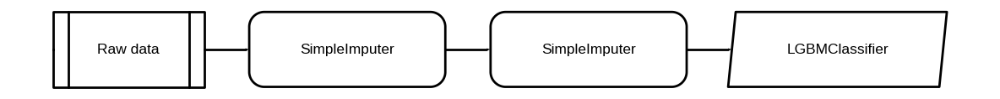

In [ ]:
evaluate_model(tuned_model)

In [ ]:
final_model = finalize_model(tuned_model)
final_model

Pipeline(memory=Memory(location=None),
         steps=[('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['loan_amnt', 'term', 'int_rate',
                                             'installment', 'grade',
                                             'sub_grade', 'emp_title',
                                             'emp_length', 'home_ownership',
                                             'annual_inc',
                                             'verification_status', 'purpose',
                                             'title', 'dti', 'earliest_cr_line',
                                             'open_acc', 'pub_rec', 'revol_bal',
                                             'revol_util', 'total_acc',
                                             '...
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.2,
                                max_depth=-1, min_child_samples=6,
                                min_child_weight=0.001, min_split_gain=0.6,
                                n_estimators=100, n_jobs=-1, num_leaves=30,
                                objective=None, random_state=42,
                                reg_alpha=0.001, reg_lambda=5, subsample=1.0,
                                subsample_for_bin=200000, subsample_freq=0))],
         verbose=False)

In [ ]:
# create copy of data drop target column
Data = df.copy()
Data.drop('loan_status', axis=1, inplace=True)
# generate predictions
predictions = predict_model(final_model, data = Data)
predictions

[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8


,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,application_type,mort_acc,pub_rec_bankruptcies,Issued_month,Issued_year,City,State,Zip,prediction_label,prediction_score
0,-0.491758,0.0,-0.483360,-0.368958,-0.616534,-0.467127,-0.229694,-0.879056,1.091067,1.714570,...,-0.008284,-0.899605,-0.03678,-1.620603,0.925224,-0.061781,0.510505,-0.580348,1,0.7860
1,-0.731615,0.0,-0.355244,-0.664114,-0.616534,-0.315634,-1.145126,-0.012662,-0.987638,-0.070252,...,-0.008284,0.795864,-0.03678,-1.620603,0.925224,-0.157220,0.821673,-1.249590,1,0.9999
2,0.179844,0.0,-0.704650,0.452159,-0.616534,-0.618620,0.658586,1.720128,1.091067,-0.823412,...,-0.008284,-0.899605,-0.03678,-1.620603,0.925224,0.232363,1.319541,-1.249590,1,0.9998
3,-0.827558,0.0,-1.636397,-0.872436,-1.366267,-1.527580,-1.251909,0.564935,1.091067,-0.447810,...,-0.008284,-0.899605,-0.03678,1.297726,0.250334,-1.145255,-0.547465,-1.584212,1,1.0000
4,1.232219,0.0,0.874662,0.925705,0.133200,0.441833,-1.049372,1.431329,-0.987638,-0.413487,...,-0.008284,-0.334449,-0.03678,-0.745104,-0.424555,-0.703357,1.070607,-0.914969,0,0.9992
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396025,-0.491758,0.0,-0.588181,-0.887563,-0.616534,-0.467127,1.296232,-0.590258,1.091067,-0.928339,...,-0.008284,-0.899605,-0.03678,1.005893,0.925224,-0.559445,-1.294267,0.088895,1,0.6755
396026,0.827459,0.0,-0.285363,1.347112,0.133200,-0.164140,-1.674297,0.276137,-0.987638,1.474305,...,-0.008284,-0.334449,-0.03678,-1.328770,0.925224,0.957175,-0.609699,-1.249590,1,0.9999
396027,-1.091402,0.0,-0.821118,-1.146912,-0.616534,-0.921607,-1.282924,-0.879056,1.091067,-0.362001,...,-0.008284,-0.899605,-0.03678,1.005893,-0.424555,0.969524,0.386038,0.758138,1,0.8648
396028,0.827459,0.0,0.418106,0.433886,0.133200,-0.012647,-0.695567,-0.879056,-0.987638,-0.104575,...,-0.008284,1.926175,-0.03678,0.422227,-1.099445,0.195218,-1.169800,-0.245726,1,0.9963
